In [41]:
import csv
import datetime
import matplotlib.pyplot as plt
from matplotlib.dates import DateFormatter
import numpy as np
import scipy.stats as sp
import pandas as pd
import seaborn as sns
from pandas.plotting import register_matplotlib_converters
register_matplotlib_converters()
sns.set(font_scale=1.1)
sns.set_palette("bright")
import io
%pylab inline
pylab.rcParams['figure.figsize'] = (15,8)
# matplotlib.rcParams.update({'font.size': 18})

Populating the interactive namespace from numpy and matplotlib


/Users/maxfrenzel/venvs/py3/lib/python3.8/site-packages/IPython/core/magics/pylab.py:159: UserWarning: pylab import has clobbered these variables: ['time', 'xticks']
`%matplotlib` prevents importing * from pylab and numpy
  warn("pylab import has clobbered these variables: %s"  % clobbered +


In [42]:
# Caffeine dictionary
caffeine_vals = {
    "Filter" : 115,
    "Espresso" : 70,
    "Coldbrew" : 150,
    "Green Tea (500ml)" : 60,
    "Green Tea (260ml)" : 30
}

# Read caffeine events from file, giving each event a time and a type
Events = []
with io.open("Caffeine.csv", "rt", encoding="utf8") as csvfile:
    
    reader = csv.reader(csvfile, delimiter=',', quotechar='"')
    
    header = next(reader)
    print(header)
    
    for row in reader:
        
        # Add up caffeine and store
        caffeine = 0
        for i in range(len(row)-2):
            if row[i+1] == '1':
                caffeine += caffeine_vals[header[i+1]]
            if row[-1] != '':
                caffeine += int(row[-1])
        
        Events.append([datetime.datetime.strptime(row[0], '%B %d, %Y %H:%M:%S'), caffeine])

['timestamp', 'Filter', 'Espresso', 'Coldbrew', 'Green Tea (500ml)', 'Green Tea (260ml)', 'Caffeine (other)']


In [43]:
# ----------------------------------
# Model caffeine in blood

# Biological half life time of caffeine (in minutes)
half_life = 4*60.0
# Variance of Gaussian modelling caffeine entering bloodstream
sigma = 60

# Temporal resolution
resolution = 5
dt = datetime.timedelta(minutes=resolution)

# Decay factor
decay_factor = (0.5)**(resolution/half_life)

# Set starting time and initialise timestamp and caffeineLevel lists
t_start = Events[0][0]
# Make sure it starts on round minute
t_start = t_start.replace(minute=0,second=0)
time = t_start + dt

timestamps = [t_start]
caffeineLevel = [0]
    
event_index = 0

# List to store events until all their caffeine is in bloodstream
past_events = []
    
while time < (Events[-1][0] + datetime.timedelta(minutes=300)):
    
    new_caffeine_level = caffeineLevel[-1] * decay_factor

    if event_index < len(Events) and time > Events[event_index][0]:
            
        # Create Gaussian that will model caffeine entering bloodstream
        gaussian = [np.exp(-(k*resolution-30)**2/sigma) for k in range(25)]
        # Normalise
        gaussian = [x * Events[event_index][1]/sum(gaussian) for x in gaussian]

        # Add Gaussian to list of past events
        past_events.append(gaussian)
            
        event_index += 1
        
    # Add caffeine for all still outstanding past events
    add_caffeine = 0.0
    for c in past_events:
        add_caffeine += c[0]
        del c[0]
        # Remove event if this was the last entry
        if c == []:
            past_events.remove(c)
                    
    new_caffeine_level += add_caffeine
    
    caffeineLevel.append(new_caffeine_level)
    timestamps.append(time)
    #print new_caffeine_level
    
    time += dt

In [44]:
timestamps[-1]

datetime.datetime(2020, 12, 31, 22, 20)

In [45]:
timestamps[-1].weekday()

3

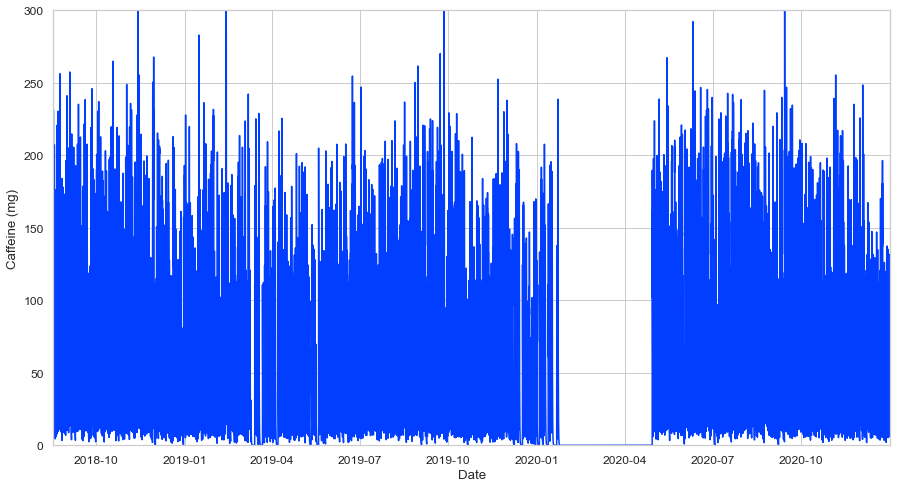

In [46]:
with sns.axes_style("whitegrid"):
    plt.plot(timestamps, caffeineLevel)
    plt.xlim([timestamps[0],timestamps[-1]])
    plt.xlabel('Date')
    plt.ylabel('Caffeine (mg)')
    plt.ylim([0,300])

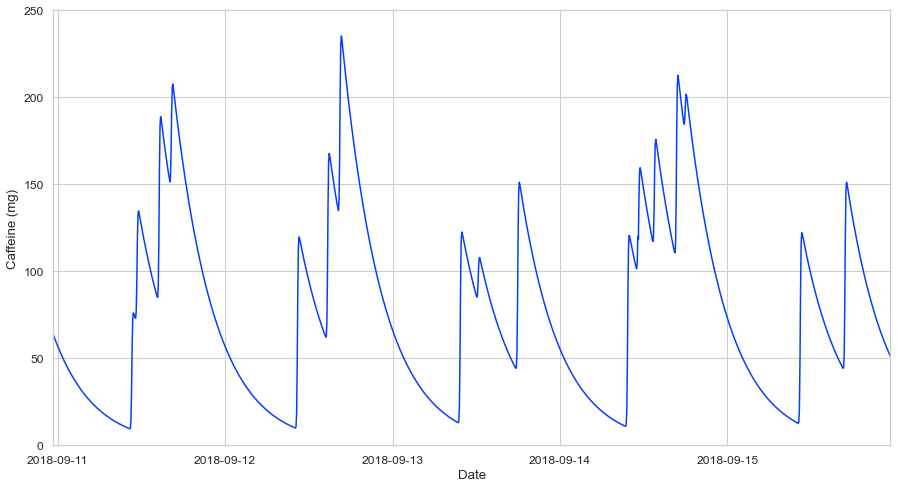

In [47]:
# zoomed in
start_index = int(24.6*(24*60)/resolution)
end_index = int(start_index + 5*(24*60)/resolution)

with sns.axes_style("whitegrid"):
    plt.plot(timestamps, caffeineLevel)
    plt.xlim([timestamps[start_index],timestamps[end_index]])
    plt.xlabel('Date')
    plt.ylabel('Caffeine (mg)')
    plt.ylim([0,250])

In [48]:
# Load alcohol and Oura data
alcohol_data = pd.read_csv("Alcohol.csv") 
oura_data = pd.read_csv("oura.csv") 

# Convert timestamps to date; Also shift alcohol timestamps by one since effect is on the following days Oura data
alcohol_data.timestamp = alcohol_data.timestamp.apply(lambda t : datetime.datetime.strptime(t, '%B %d, %Y %H:%M:%S').date()+datetime.timedelta(days=1))
alcohol_data = alcohol_data.rename(index=str, columns={"timestamp": "date"})
oura_data.date = oura_data.date.apply(lambda t : datetime.datetime.strptime(t, '%Y-%m-%d').date())

# Turn alcohol into single column
alc_list = []
alc_level_list = []
for k in range(len(alcohol_data)):
    if alcohol_data['None'][k] == 1.0:
        alc_list.append('None')
        alc_level_list.append(0)
    elif alcohol_data['A bit'][k] == 1.0:
        alc_list.append('A bit')
        alc_level_list.append(1)
    elif alcohol_data['Quite a bit'][k] == 1.0:
        alc_list.append('Quite a bit')
        alc_level_list.append(3)
    elif alcohol_data['A lot'][k] == 1.0:
        alc_list.append('A lot')
        alc_level_list.append(6)
    else:
        alc_list.append('Error')
alcohol_data['Alcohol'] = np.array(alc_list)
alcohol_data['Alcohol'] = alcohol_data['Alcohol'].astype('category')
alcohol_data['Alcohol Level'] = np.array(alc_level_list)

# Merge datasets
dataframe = pd.merge(oura_data, alcohol_data.drop(labels=['None','A bit','Quite a bit','A lot'], axis=1), on='date')

# Remove rows without a sleep score
dataframe = dataframe.dropna(subset = ['Sleep Score']).reset_index()

In [49]:
# Daily caffeine average
time = datetime.datetime(2018, 1, 1, 0, 0)

timestamps_average = [time]
caffeine_average = []
caffeine_average_weekday = []
caffeine_average_weekend = []

for k in range(int(1440/resolution)-1):
    time += dt
    timestamps_average.append(time)
    
# Total
for time in timestamps_average:
    # Times in total list
    occurences = [t for t in timestamps if t.time().replace(second=0) == time.time()]
    occurences_weekday = [t for t in occurences if t.weekday() not in [5,6]]
    occurences_weekend = [t for t in occurences if t.weekday() in [5,6]]
    
    # Only add value if the following day also has Oura data
    occurences = [t for t in occurences if (t+datetime.timedelta(days=1)).date() in list(dataframe['date'])]
    occurences_weekday = [t for t in occurences_weekday if (t+datetime.timedelta(days=1)).date() in list(dataframe['date'])]
    occurences_weekend = [t for t in occurences_weekend if (t+datetime.timedelta(days=1)).date() in list(dataframe['date'])]
    
    caffeine_list = [caffeineLevel[timestamps.index(t)] for t in occurences]
    caffeine_list_weekday = [caffeineLevel[timestamps.index(t)] for t in occurences_weekday]
    caffeine_list_weekend = [caffeineLevel[timestamps.index(t)] for t in occurences_weekend]
    
    # Calculate averages
    if len(occurences) != 0:
        caffeine_average.append(sum(caffeine_list)/len(occurences))
    else:
        caffeine_average.append(0.0)
    if len(occurences_weekday) != 0:
        caffeine_average_weekday.append(sum(caffeine_list_weekday)/len(occurences_weekday))
    else:
        caffeine_average_weekday.append(0.0)
    if len(occurences_weekend) != 0:
        caffeine_average_weekend.append(sum(caffeine_list_weekend)/len(occurences_weekend))
    else:
        caffeine_average_weekend.append(0.0)
        
# Add dummy date back in
timestamps_average = [t.time() for t in timestamps_average]
timestamps_average = [datetime.datetime.combine(datetime.date.today(), x) for x in timestamps_average]

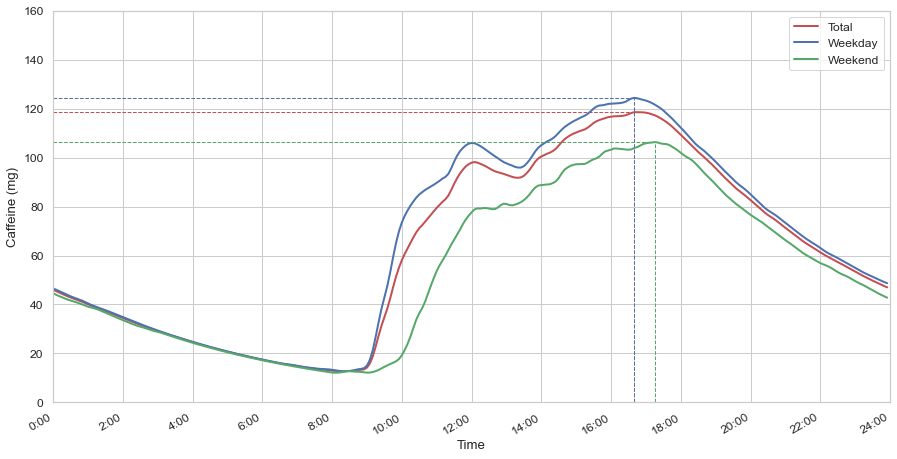

In [50]:
# Find maxima
max_index = caffeine_average.index(max(caffeine_average))
max_index_weekday = caffeine_average_weekday.index(max(caffeine_average_weekday))
max_index_weekend = caffeine_average_weekend.index(max(caffeine_average_weekend))

# Plot averages
with sns.axes_style("whitegrid"):
    xticks = [(timestamps_average[0] + datetime.timedelta(hours=2*k)) for k in range(13)]
    
    plt.plot(timestamps_average, caffeine_average, label='Total', color='r', linewidth=2)
    plt.plot([timestamps_average[0],timestamps_average[max_index]], [caffeine_average[max_index],caffeine_average[max_index]], '--', color='r', linewidth=1)
    plt.plot([timestamps_average[max_index],timestamps_average[max_index]], [0.0,caffeine_average[max_index]], '--', color='r', linewidth=1)
    
    plt.plot(timestamps_average, caffeine_average_weekday, label='Weekday', color='b', linewidth=2)
    plt.plot([timestamps_average[0],timestamps_average[max_index_weekday]], [caffeine_average_weekday[max_index_weekday],caffeine_average_weekday[max_index_weekday]], '--', color='b', linewidth=1)
    plt.plot([timestamps_average[max_index_weekday],timestamps_average[max_index_weekday]], [0.0,caffeine_average_weekday[max_index_weekday]], '--', color='b', linewidth=1)
    
    plt.plot(timestamps_average, caffeine_average_weekend, label='Weekend', color='g', linewidth=2)
    plt.plot([timestamps_average[0],timestamps_average[max_index_weekend]], [caffeine_average_weekend[max_index_weekend],caffeine_average_weekend[max_index_weekend]], '--', color='g', linewidth=1)
    plt.plot([timestamps_average[max_index_weekend],timestamps_average[max_index_weekend]], [0.0,caffeine_average_weekend[max_index_weekend]], '--', color='g', linewidth=1)
    
    plt.xticks(xticks)
    plt.gcf().autofmt_xdate()
    
    labels = [item.get_text() for item in plt.gca().get_xticklabels()]
    labels = [f'{2*i}:00' for i in range(len(labels))]
    plt.gca().set_xticklabels(labels)
    
    plt.ylim([0,160])
    plt.xlim([xticks[0],xticks[-1]])
    plt.legend()
    plt.xlabel('Time')
    plt.ylabel('Caffeine (mg)')

In [51]:
print(caffeine_average_weekday[max_index])
print(caffeine_average_weekend[max_index])
print(caffeine_average[max_index])
print(timestamps_average[max_index])

124.39238047282811
103.91375112083429
118.57384927599178
2021-01-09 16:40:00


In [52]:
dataframe.keys()

Index(['index', 'date', 'Sleep Score', 'Total Sleep Score', 'REM Sleep Score',
       'Deep Sleep Score', 'Sleep Efficiency Score', 'Restfulness Score',
       'Sleep Latency Score', 'Sleep Timing Score', 'Total Bedtime',
       'Total Sleep Time', 'Awake Time', 'REM Sleep Time', 'Light Sleep Time',
       'Deep Sleep Time', 'Restless Sleep', 'Sleep Efficiency',
       'Sleep Latency', 'Sleep Timing', 'Sleep Timing.1', 'Bedtime Start',
       'Bedtime End', 'Average Resting Heart Rate',
       'Lowest Resting Heart Rate', 'Average HRV',
       'Temperature Deviation (°C)', 'Respiratory Rate', 'Activity Score',
       'Stay Active Score', 'Move Every Hour Score',
       'Meet Daily Targets Score', 'Training Frequency Score',
       'Training Volume Score', 'Recovery Time Score', 'Activity Burn',
       'Total Burn', 'Target Calories', 'Steps', 'Daily Movement',
       'Inactive Time', 'Rest Time', 'Low Activity Time',
       'Medium Activity Time', 'High Activity Time', 'Non-wear Time',

In [53]:
# Add some more readable units
dataframe['Total Bedtime (h)'] = dataframe['Total Bedtime'] / (60*60)
dataframe['Total Sleep Time (h)'] = dataframe['Total Sleep Time'] / (60*60)
dataframe['Awake Time (h)'] = dataframe['Awake Time'] / (60*60)
dataframe['REM Sleep Time (h)'] = dataframe['REM Sleep Time'] / (60*60)
dataframe['Light Sleep Time (h)'] = dataframe['Light Sleep Time'] / (60*60)
dataframe['Deep Sleep Time (h)'] = dataframe['Deep Sleep Time'] / (60*60)
dataframe['Sleep Latency (min)'] = dataframe['Sleep Latency'] / (60)
dataframe['Respiratory Rate (1/min)'] = dataframe['Respiratory Rate']
dataframe['Activity Burn (Cal)'] = dataframe['Activity Burn']
dataframe['Average HRV (ms)'] = dataframe['Average HRV']

dataframe = dataframe.drop(['Total Bedtime', 
                            'Total Sleep Time',
                            'Awake Time',
                            'REM Sleep Time',
                            'Light Sleep Time',
                            'Deep Sleep Time',
                            'Sleep Latency',
                            'Sleep Timing.1',
                            'Respiratory Rate',
                            'Activity Burn'], axis=1)

In [54]:
dataframe['REM Sleep Time (h)']

0      2.550000
1      1.641667
2      1.650000
3      1.608333
4      2.366667
         ...   
627    1.508333
628    1.916667
629    1.725000
630    1.500000
631    1.516667
Name: REM Sleep Time (h), Length: 632, dtype: float64

In [55]:
dataframe.keys()

Index(['index', 'date', 'Sleep Score', 'Total Sleep Score', 'REM Sleep Score',
       'Deep Sleep Score', 'Sleep Efficiency Score', 'Restfulness Score',
       'Sleep Latency Score', 'Sleep Timing Score', 'Restless Sleep',
       'Sleep Efficiency', 'Sleep Timing', 'Bedtime Start', 'Bedtime End',
       'Average Resting Heart Rate', 'Lowest Resting Heart Rate',
       'Average HRV', 'Temperature Deviation (°C)', 'Activity Score',
       'Stay Active Score', 'Move Every Hour Score',
       'Meet Daily Targets Score', 'Training Frequency Score',
       'Training Volume Score', 'Recovery Time Score', 'Total Burn',
       'Target Calories', 'Steps', 'Daily Movement', 'Inactive Time',
       'Rest Time', 'Low Activity Time', 'Medium Activity Time',
       'High Activity Time', 'Non-wear Time', 'Average MET',
       'Long Periods of Inactivity', 'Readiness Score', 'Previous Night Score',
       'Sleep Balance Score', 'Previous Day Activity Score',
       'Activity Balance Score', 'Temperatur

In [56]:
dataframe['date'][0]

datetime.date(2018, 8, 20)

In [57]:
# Function to find nearest (datetime) item from list
def nearest(items, pivot):
    return min(items, key=lambda x: abs(x - pivot))

# Find caffeine at bedtime for each day
# Add new column to dataframe
dataframe['Bedtime Caffeine (mg)'] = np.zeros(len(dataframe))

bedtimes=[]
bedtimes_weekday=[]
bedtimes_weekend=[]
bt_caffeine=[]
bt_caffeine_weekday=[]
bt_caffeine_weekend=[]

alc_bedtimes = {
    'None':[],
    'A bit':[],
    'Quite a bit':[],
    'A lot':[]
}

for k in range(len(dataframe)):
    # Find relevant caffeine value
    bedtime = datetime.datetime.strptime(dataframe['Bedtime Start'][k][:-6], '%Y-%m-%dT%H:%M:%S')
    
    nearest_time = nearest(timestamps, bedtime)
    bedtime_caffeine = caffeineLevel[timestamps.index(nearest_time)]
    
    bedtimes.append(nearest_time)
    bt_caffeine.append(bedtime_caffeine)
    # TODO: Check if before or after midnight
    if nearest_time.weekday() in [5,6]:
        bedtimes_weekend.append(nearest_time)
        bt_caffeine_weekend.append(bedtime_caffeine)
    else:
        bedtimes_weekday.append(nearest_time)
        bt_caffeine_weekday.append(bedtime_caffeine)
        
    alc_bedtimes[dataframe['Alcohol'][k]].append(nearest_time)
        
    dataframe['Bedtime Caffeine (mg)'][k] = bedtime_caffeine
    
# Add columns for sleep ratios
dataframe['Deep Sleep Ratio'] = dataframe['Deep Sleep Time (h)']/dataframe['Total Sleep Time (h)']
dataframe['Light Sleep Ratio'] = dataframe['Light Sleep Time (h)']/dataframe['Total Sleep Time (h)']
dataframe['REM Sleep Ratio'] = dataframe['REM Sleep Time (h)']/dataframe['Total Sleep Time (h)']
dataframe['Awake Ratio'] = dataframe['Awake Time (h)']/dataframe['Total Sleep Time (h)']

len(dataframe)

<ipython-input-57-bbb81c326006>:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataframe['Bedtime Caffeine (mg)'][k] = bedtime_caffeine


632

In [58]:
# Find average bedtimes
def average_time(times):
    timestamps=[]
    for t in times:
        if t.hour > 12:
            timestamps.append(t.replace(year=2018,month=1,day=1).timestamp())
        else:
            timestamps.append(t.replace(year=2018,month=1,day=2).timestamp())
    average_timestamp = sum(timestamps)/len(timestamps)
    return datetime.datetime.fromtimestamp(average_timestamp).time()
    
# Find average bedtimes
bedtime_total = average_time(bedtimes)
bedtime_weekday = average_time(bedtimes_weekday)
bedtime_weekend = average_time(bedtimes_weekend)

av_bt_caffeine = sum(bt_caffeine)/len(bt_caffeine)
av_bt_caffeine_weekday = sum(bt_caffeine_weekday)/len(bt_caffeine_weekday)
av_bt_caffeine_weekend = sum(bt_caffeine_weekend)/len(bt_caffeine_weekend)

In [59]:
timestamps

[datetime.datetime(2018, 8, 17, 9, 0),
 datetime.datetime(2018, 8, 17, 9, 5),
 datetime.datetime(2018, 8, 17, 9, 10),
 datetime.datetime(2018, 8, 17, 9, 15),
 datetime.datetime(2018, 8, 17, 9, 20),
 datetime.datetime(2018, 8, 17, 9, 25),
 datetime.datetime(2018, 8, 17, 9, 30),
 datetime.datetime(2018, 8, 17, 9, 35),
 datetime.datetime(2018, 8, 17, 9, 40),
 datetime.datetime(2018, 8, 17, 9, 45),
 datetime.datetime(2018, 8, 17, 9, 50),
 datetime.datetime(2018, 8, 17, 9, 55),
 datetime.datetime(2018, 8, 17, 10, 0),
 datetime.datetime(2018, 8, 17, 10, 5),
 datetime.datetime(2018, 8, 17, 10, 10),
 datetime.datetime(2018, 8, 17, 10, 15),
 datetime.datetime(2018, 8, 17, 10, 20),
 datetime.datetime(2018, 8, 17, 10, 25),
 datetime.datetime(2018, 8, 17, 10, 30),
 datetime.datetime(2018, 8, 17, 10, 35),
 datetime.datetime(2018, 8, 17, 10, 40),
 datetime.datetime(2018, 8, 17, 10, 45),
 datetime.datetime(2018, 8, 17, 10, 50),
 datetime.datetime(2018, 8, 17, 10, 55),
 datetime.datetime(2018, 8, 17, 

In [60]:
bedtime_weekday

datetime.time(0, 7, 44, 335664)

In [61]:
# Find average bedtimes across alcohol groups
alc_bedtimes_average={
    'None':average_time(alc_bedtimes['None']),
    'A bit':average_time(alc_bedtimes['A bit']),
    'Quite a bit':average_time(alc_bedtimes['Quite a bit']),
    'A lot':average_time(alc_bedtimes['A lot'])
}
alc_bedtimes_average

{'None': datetime.time(23, 42, 13, 663366),
 'A bit': datetime.time(23, 57, 42, 895928),
 'Quite a bit': datetime.time(0, 49, 26, 666667),
 'A lot': datetime.time(2, 30, 42, 857143)}

In [62]:
def times_to_hours(times):
    hours = []
    not_list = True
    if type(times) != list:
        times = [times]
        not_list = False
    for t in times:
        if t.hour > 12:
            hours.append(-((24.0-t.hour) - (60-t.minute)/60) - (60-t.second)/(60**2))
        else:
            hours.append(t.hour + (60-t.minute)/60 + (60-t.second)/(60**2))
    
    if not_list:        
        return hours
    else:
        return hours[0]

# alc_bedtimes_hour={
#     'None':times_to_hours(alc_bedtimes['None']),
#     'A bit':times_to_hours(alc_bedtimes['A bit']),
#     'Quite a bit':times_to_hours(alc_bedtimes['Quite a bit']),
#     'A lot':times_to_hours(alc_bedtimes['A lot'])
# }
# alc_bedtimes_hour

# Add new column to dataframe
dataframe['Bedtime Hour'] = np.zeros(len(dataframe))

for k in range(len(dataframe)):
    dataframe['Bedtime Hour'][k] = times_to_hours(datetime.datetime.strptime(dataframe['Bedtime Start'][k][:-6], '%Y-%m-%dT%H:%M:%S'))

<ipython-input-62-cb50dd8327c1>:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataframe['Bedtime Hour'][k] = times_to_hours(datetime.datetime.strptime(dataframe['Bedtime Start'][k][:-6], '%Y-%m-%dT%H:%M:%S'))


In [63]:
# Create groups for alcohol level and order
dataframe_grouped = dataframe.groupby('Alcohol')
dataframe_lowbooze = pd.concat([dataframe_grouped.get_group('None'),dataframe_grouped.get_group('A bit')])

dataframe['Alcohol'] = dataframe['Alcohol'].cat.reorder_categories(['None','A bit','Quite a bit','A lot'], ordered=True)

In [64]:
datetime.datetime.combine(datetime.date.today(), bedtime_total)

datetime.datetime(2021, 1, 9, 0, 18, 50, 696203)

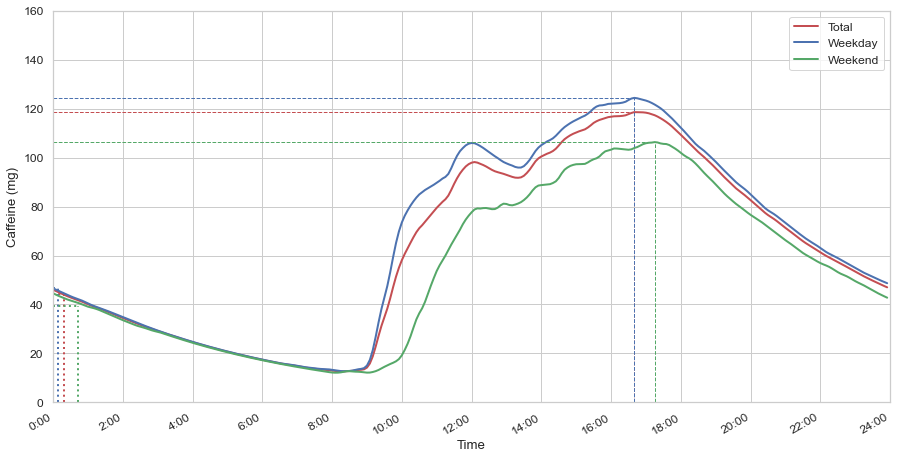

In [65]:
# Find maxima
max_index = caffeine_average.index(max(caffeine_average))
max_index_weekday = caffeine_average_weekday.index(max(caffeine_average_weekday))
max_index_weekend = caffeine_average_weekend.index(max(caffeine_average_weekend))

bedtime_total_date = datetime.datetime.combine(datetime.date.today(), bedtime_total)
bedtime_weekday_date = datetime.datetime.combine(datetime.date.today(), bedtime_weekday)
bedtime_weekend_date = datetime.datetime.combine(datetime.date.today(), bedtime_weekend)


# Plot averages
with sns.axes_style("whitegrid"):
    xticks = [(timestamps_average[0] + datetime.timedelta(hours=2*k)) for k in range(13)]
    
    plt.plot(timestamps_average, caffeine_average, label='Total', color='r', linewidth=2)
    plt.plot([timestamps_average[0],timestamps_average[max_index]], [caffeine_average[max_index],caffeine_average[max_index]], '--', color='r', linewidth=1)
    plt.plot([timestamps_average[max_index],timestamps_average[max_index]], [0.0,caffeine_average[max_index]], '--', color='r', linewidth=1)
    plt.plot([timestamps_average[0],bedtime_total_date], [av_bt_caffeine, av_bt_caffeine], ':', color='r', linewidth=2)
    plt.plot([bedtime_total_date,bedtime_total_date], [0,av_bt_caffeine], ':', color='r', linewidth=2)
    
    plt.plot(timestamps_average, caffeine_average_weekday, label='Weekday', color='b', linewidth=2)
    plt.plot([timestamps_average[0],timestamps_average[max_index_weekday]], [caffeine_average_weekday[max_index_weekday],caffeine_average_weekday[max_index_weekday]], '--', color='b', linewidth=1)
    plt.plot([timestamps_average[max_index_weekday],timestamps_average[max_index_weekday]], [0.0,caffeine_average_weekday[max_index_weekday]], '--', color='b', linewidth=1)
    plt.plot([timestamps_average[0],bedtime_weekday_date], [av_bt_caffeine_weekday,av_bt_caffeine_weekday], ':', color='b', linewidth=2)
    plt.plot([bedtime_weekday_date,bedtime_weekday_date], [0,av_bt_caffeine_weekday], ':', color='b', linewidth=2)
    
    plt.plot(timestamps_average, caffeine_average_weekend, label='Weekend', color='g', linewidth=2)
    plt.plot([timestamps_average[0],timestamps_average[max_index_weekend]], [caffeine_average_weekend[max_index_weekend],caffeine_average_weekend[max_index_weekend]], '--', color='g', linewidth=1)
    plt.plot([timestamps_average[max_index_weekend],timestamps_average[max_index_weekend]], [0.0,caffeine_average_weekend[max_index_weekend]], '--', color='g', linewidth=1)
    plt.plot([timestamps_average[0],bedtime_weekend_date], [av_bt_caffeine_weekend,av_bt_caffeine_weekend], ':', color='g', linewidth=2)
    plt.plot([bedtime_weekend_date,bedtime_weekend_date], [0,av_bt_caffeine_weekend], ':', color='g', linewidth=2)


    plt.xticks(xticks)
    plt.gcf().autofmt_xdate()
    
    labels = [item.get_text() for item in plt.gca().get_xticklabels()]
    labels = [f'{2*i}:00' for i in range(len(labels))]
    plt.gca().set_xticklabels(labels)
    
    plt.ylim([0,160])
    plt.xlim([xticks[0],xticks[-1]])
    plt.legend()
    plt.xlabel('Time')
    plt.ylabel('Caffeine (mg)')

In [66]:
dataframe.corr()

,index,Sleep Score,Total Sleep Score,REM Sleep Score,Deep Sleep Score,Sleep Efficiency Score,Restfulness Score,Sleep Latency Score,Sleep Timing Score,Restless Sleep,...,Sleep Latency (min),Respiratory Rate (1/min),Activity Burn (Cal),Average HRV (ms),Bedtime Caffeine (mg),Deep Sleep Ratio,Light Sleep Ratio,REM Sleep Ratio,Awake Ratio,Bedtime Hour
index,1.000000,0.048125,0.172266,-0.064118,0.281043,0.032658,-0.557495,-0.137679,0.133043,-0.464887,...,-0.074445,-0.307538,-0.339721,-0.125765,0.062265,0.408698,-0.150802,-0.284166,0.005300,-0.148615
Sleep Score,0.048125,1.000000,0.885535,0.669293,0.423652,0.351071,0.148671,0.242855,0.539525,0.011209,...,0.132113,-0.148449,0.202835,0.454703,0.224913,0.018416,-0.267115,0.335287,-0.345681,-0.664164
Total Sleep Score,0.172266,0.885535,1.000000,0.524119,0.366755,0.180192,-0.048087,0.062829,0.315084,0.005446,...,0.188913,-0.145896,0.112906,0.442052,0.225098,-0.014946,-0.087867,0.135259,-0.167683,-0.596142
REM Sleep Score,-0.064118,0.669293,0.524119,1.000000,0.142447,0.110002,0.095433,0.069688,0.132640,0.020627,...,0.026536,-0.002399,0.062252,0.131181,0.104299,-0.155350,-0.477819,0.823587,-0.126584,-0.269578
Deep Sleep Score,0.281043,0.423652,0.366755,0.142447,1.000000,0.220133,-0.140639,0.014454,0.238879,-0.118682,...,0.149136,-0.204452,0.041752,0.353620,0.028310,0.529557,-0.428117,-0.057014,-0.192280,-0.269859
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Deep Sleep Ratio,0.408698,0.018416,-0.014946,-0.155350,0.529557,0.118900,-0.244793,-0.011097,0.165233,-0.365802,...,-0.042543,-0.310326,-0.044602,0.310542,-0.128540,1.000000,-0.692366,-0.262878,-0.085214,-0.068009
Light Sleep Ratio,-0.150802,-0.267115,-0.087867,-0.477819,-0.428117,-0.134991,0.069452,-0.044981,-0.131516,0.266557,...,0.075094,0.186683,0.004473,-0.224431,0.097872,-0.692366,1.000000,-0.514162,0.132109,0.070524
REM Sleep Ratio,-0.284166,0.335287,0.135259,0.823587,-0.057014,0.039171,0.198113,0.073337,-0.020551,0.078393,...,-0.049843,0.119254,0.047037,-0.069036,0.021922,-0.262878,-0.514162,1.000000,-0.075359,-0.013462
Awake Ratio,0.005300,-0.345681,-0.167683,-0.126584,-0.192280,-0.981593,-0.306608,-0.150350,-0.070140,-0.049798,...,0.194044,0.202666,-0.089824,-0.116621,0.065463,-0.085214,0.132109,-0.075359,1.000000,-0.063722


/Users/maxfrenzel/venvs/py3/lib/python3.8/site-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/Users/maxfrenzel/venvs/py3/lib/python3.8/site-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/Users/maxfrenzel/venvs/py3/lib/python3.8/site-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar 

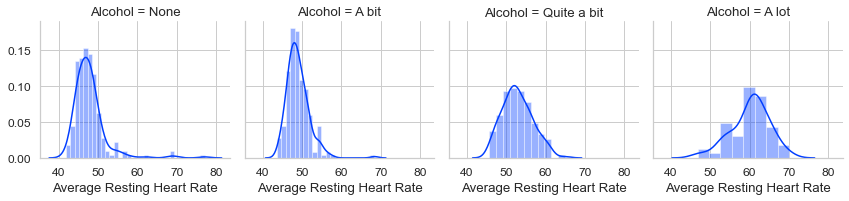

In [67]:
sns.set(font_scale=1.1)
sns.set_palette("bright")
with sns.axes_style("whitegrid"):
    g = sns.FacetGrid(dataframe, col='Alcohol')
    g.map(sns.distplot, "Average Resting Heart Rate")

/Users/maxfrenzel/venvs/py3/lib/python3.8/site-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/Users/maxfrenzel/venvs/py3/lib/python3.8/site-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/Users/maxfrenzel/venvs/py3/lib/python3.8/site-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar 

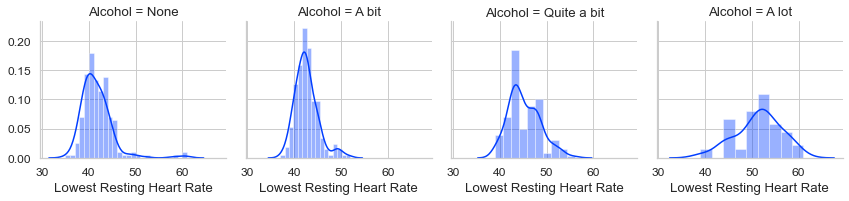

In [68]:
sns.set(font_scale=1.1)
sns.set_palette("bright")
with sns.axes_style("whitegrid"):
    g = sns.FacetGrid(dataframe, col='Alcohol')
    g.map(sns.distplot, "Lowest Resting Heart Rate")

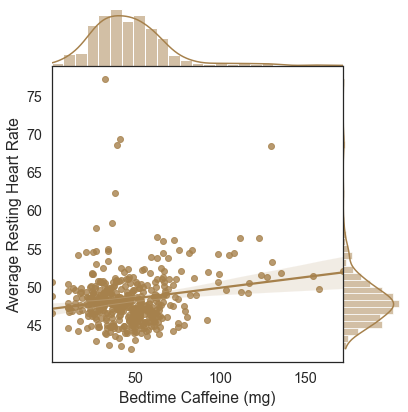

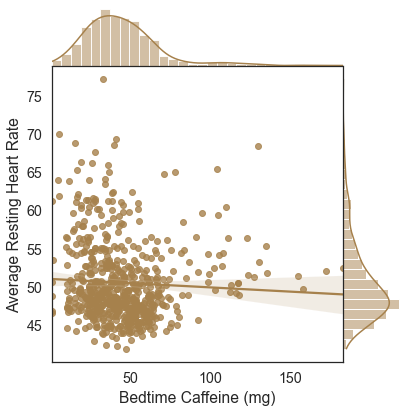

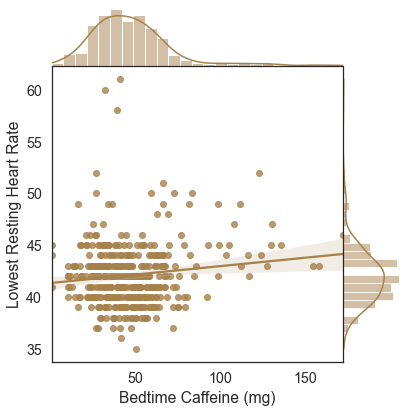

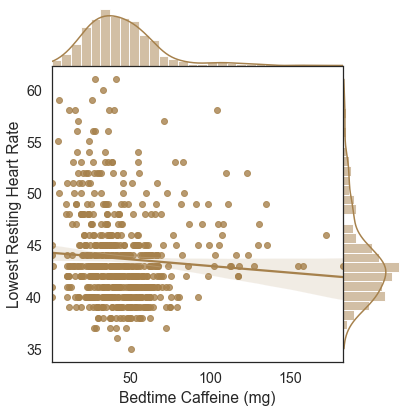

In [69]:
sns.set(font_scale=1.3)
with sns.axes_style("white"):
    sns.jointplot(data=dataframe_lowbooze, x='Bedtime Caffeine (mg)', y='Average Resting Heart Rate', kind='reg', color=sns.xkcd_rgb["coffee"], space=0)
    sns.jointplot(data=dataframe, x='Bedtime Caffeine (mg)', y='Average Resting Heart Rate', kind='reg', color=sns.xkcd_rgb["coffee"], space=0)
    sns.jointplot(data=dataframe_lowbooze, x='Bedtime Caffeine (mg)', y='Lowest Resting Heart Rate', kind='reg', color=sns.xkcd_rgb["coffee"], space=0)
    sns.jointplot(data=dataframe, x='Bedtime Caffeine (mg)', y='Lowest Resting Heart Rate', kind='reg', color=sns.xkcd_rgb["coffee"], space=0)

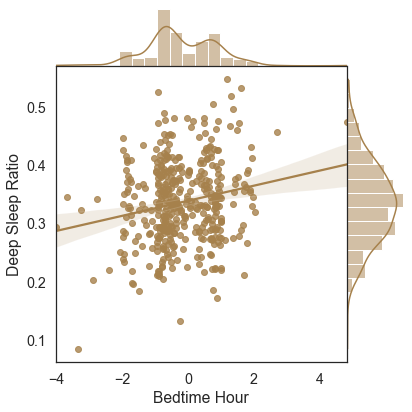

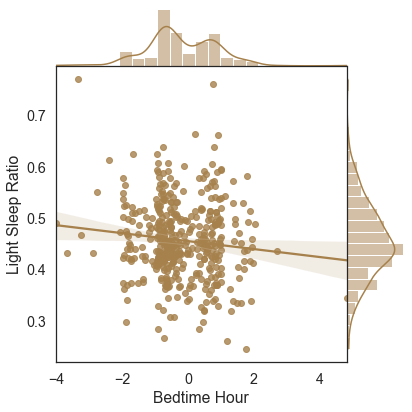

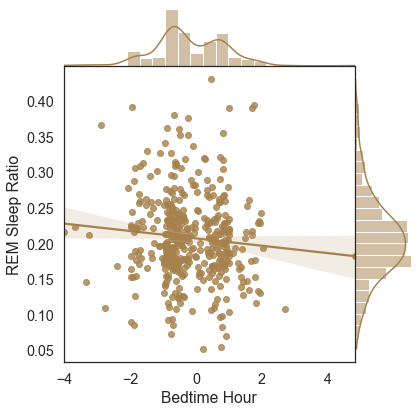

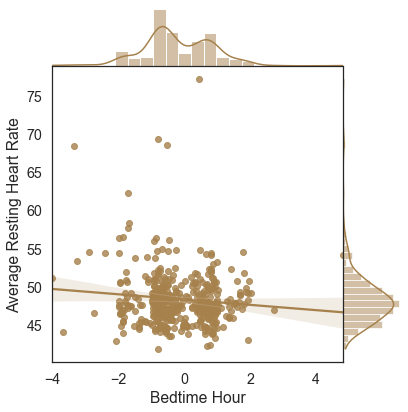

In [70]:
with sns.axes_style("white"):
    sns.jointplot(data=dataframe_lowbooze, x='Bedtime Hour', y='Deep Sleep Ratio', kind='reg', color=sns.xkcd_rgb["coffee"], space=0)
    sns.jointplot(data=dataframe_lowbooze, x='Bedtime Hour', y='Light Sleep Ratio', kind='reg', color=sns.xkcd_rgb["coffee"], space=0)
    sns.jointplot(data=dataframe_lowbooze, x='Bedtime Hour', y='REM Sleep Ratio', kind='reg', color=sns.xkcd_rgb["coffee"], space=0)
    sns.jointplot(data=dataframe_lowbooze, x='Bedtime Hour', y='Average Resting Heart Rate', kind='reg', color=sns.xkcd_rgb["coffee"], space=0)


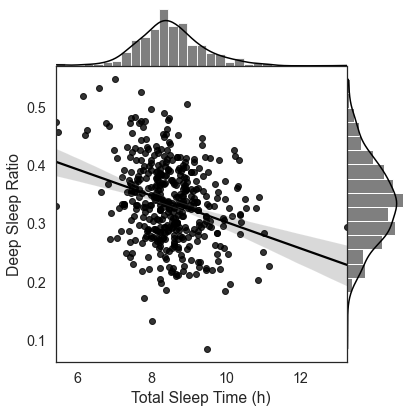

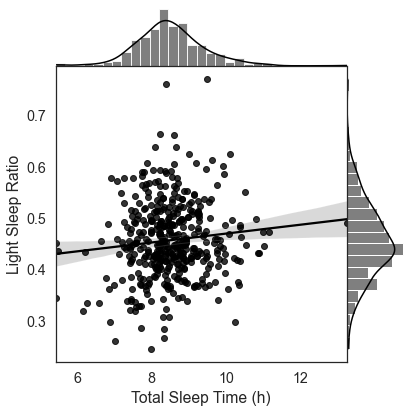

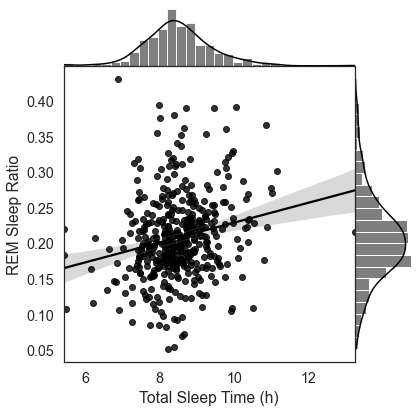

In [71]:
with sns.axes_style("white"):
    sns.jointplot(data=dataframe_lowbooze, x='Total Sleep Time (h)', y='Deep Sleep Ratio', kind='reg', color='black', space=0)
    sns.jointplot(data=dataframe_lowbooze, x='Total Sleep Time (h)', y='Light Sleep Ratio', kind='reg', color='black', space=0)
    sns.jointplot(data=dataframe_lowbooze, x='Total Sleep Time (h)', y='REM Sleep Ratio', kind='reg', color='black', space=0)
#     sns.jointplot(data=dataframe_lowbooze, x='Light Sleep Ratio', y='REM Sleep Ratio', kind='reg', color='black', space=0)
#     sns.jointplot(data=dataframe_lowbooze, x='Light Sleep Ratio', y='Deep Sleep Ratio', kind='reg', color='black', space=0)
#     sns.jointplot(data=dataframe_lowbooze, x='Deep Sleep Ratio', y='REM Sleep Ratio', kind='reg', color='black', space=0)
#     sns.jointplot(data=dataframe_lowbooze, x='Bedtime Hour', y='Deep Sleep Ratio', kind='reg', color='black', space=0)
#     sns.jointplot(data=dataframe_lowbooze, x='Bedtime Hour', y='Light Sleep Ratio', kind='reg', color='black', space=0)
#     sns.jointplot(data=dataframe_lowbooze, x='Bedtime Hour', y='REM Sleep Ratio', kind='reg', color='black', space=0)

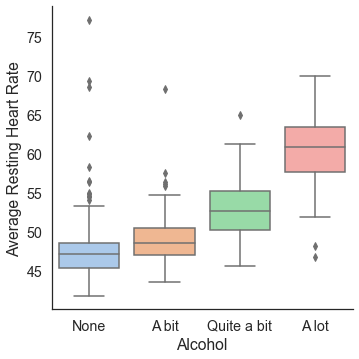

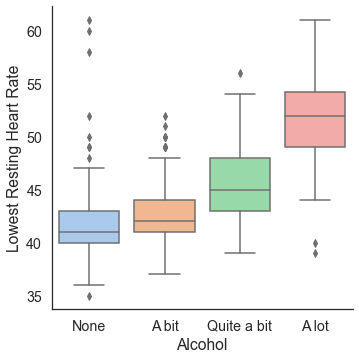

In [72]:
with sns.axes_style("white"):
    ax = sns.catplot(x="Alcohol", y="Average Resting Heart Rate", kind="box", data=dataframe, palette="pastel")
    ax = sns.catplot(x="Alcohol", y="Lowest Resting Heart Rate", kind="box", data=dataframe, palette="pastel")

/Users/maxfrenzel/venvs/py3/lib/python3.8/site-packages/seaborn/axisgrid.py:1598: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  f = plt.figure(figsize=(height, height))


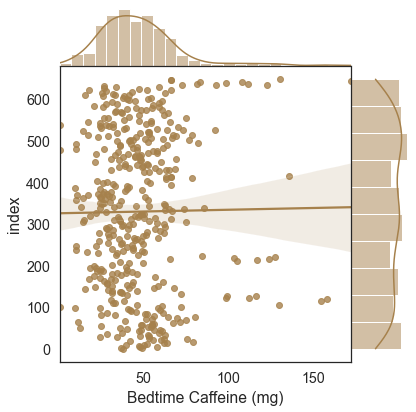

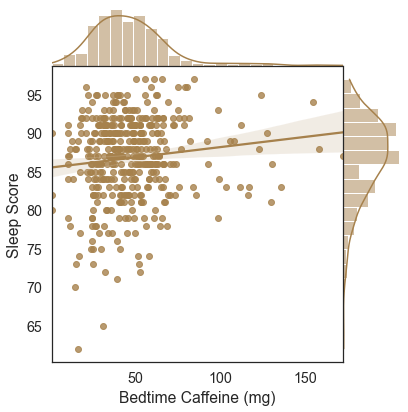

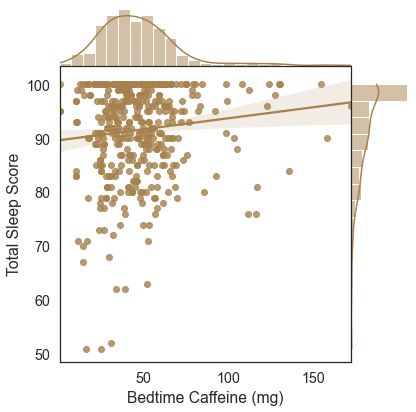

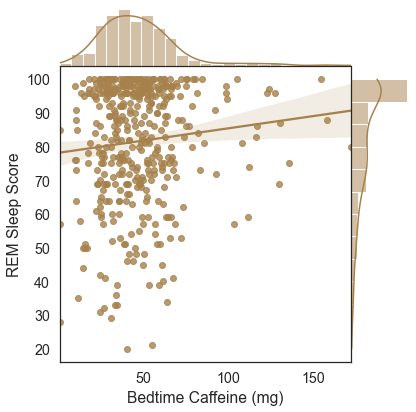

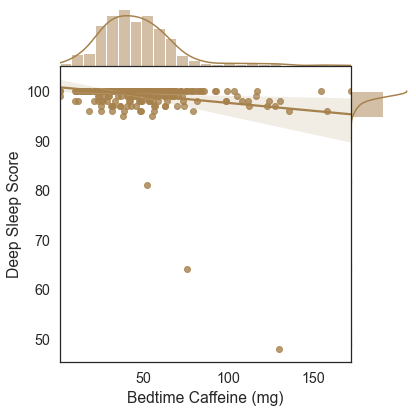

...

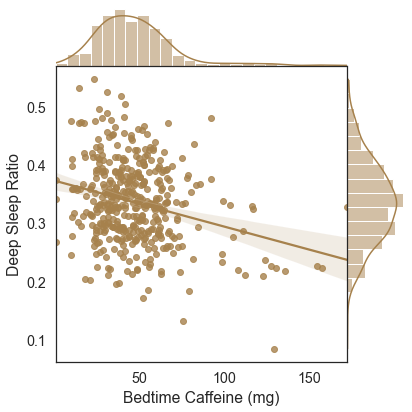

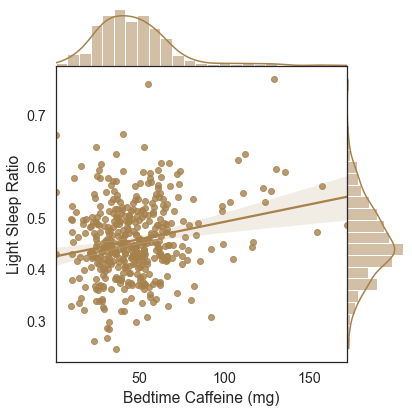

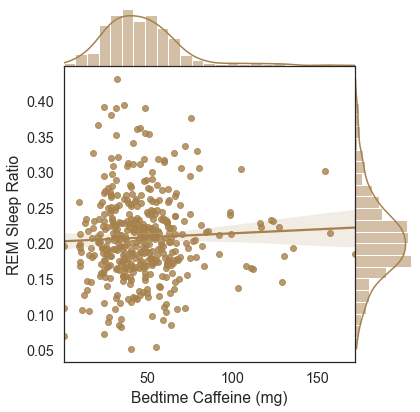

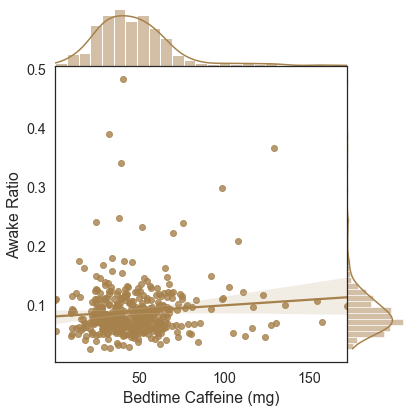

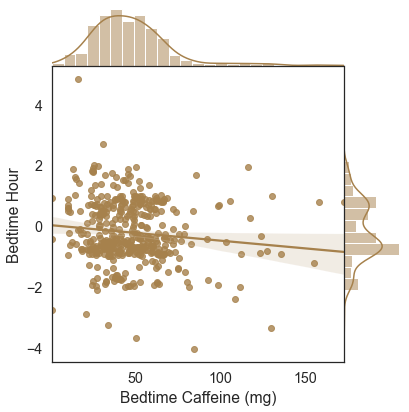

In [73]:
with sns.axes_style("white"):
    for col in list(dataframe):
        if dataframe[col].dtype in (float64, int64):
            try:
                sns.jointplot(data=dataframe_lowbooze, x='Bedtime Caffeine (mg)', y=col, kind='reg', color=sns.xkcd_rgb["coffee"], space=0)
            except:
                pass

/Users/maxfrenzel/venvs/py3/lib/python3.8/site-packages/seaborn/axisgrid.py:1598: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  f = plt.figure(figsize=(height, height))


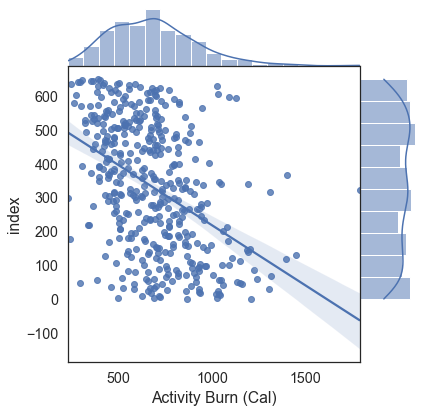

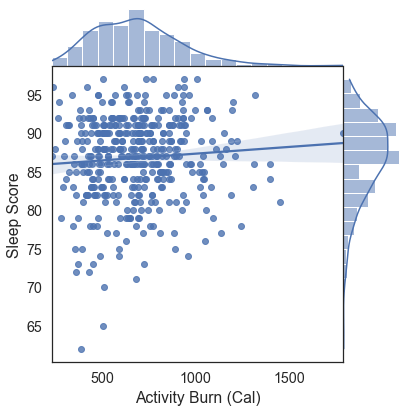

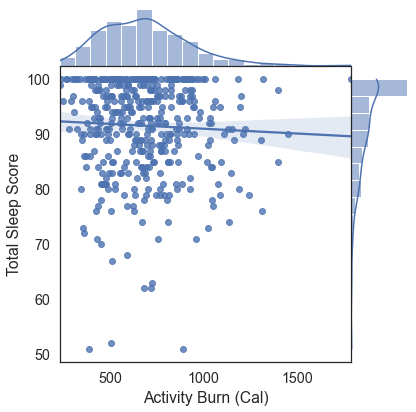

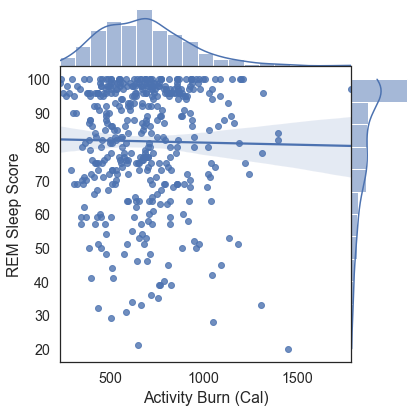

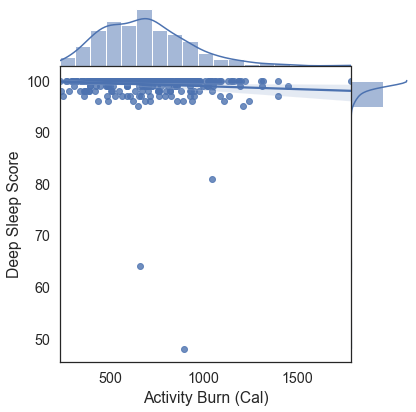

...

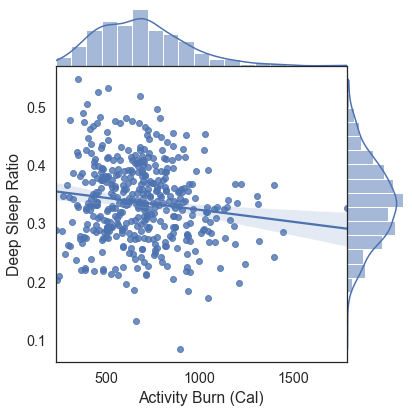

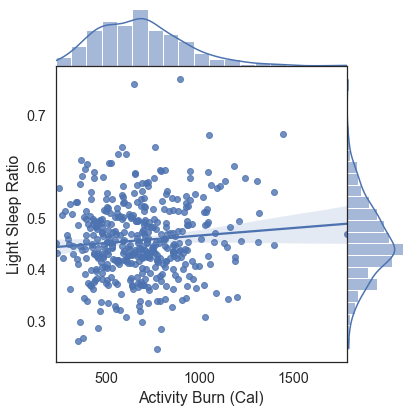

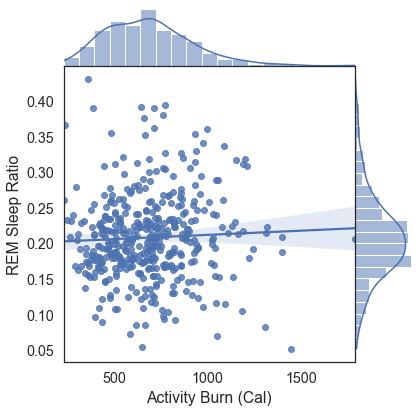

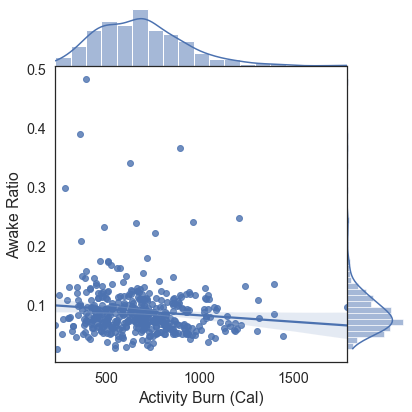

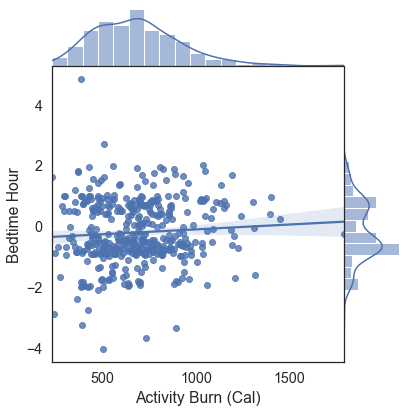

In [74]:
with sns.axes_style("white"):
    for col in list(dataframe):
        if dataframe[col].dtype in (float64, int64):
            try:
                sns.jointplot(data=dataframe_lowbooze, x='Activity Burn (Cal)', y=col, kind='reg', color='b', space=0)
            except:
                pass

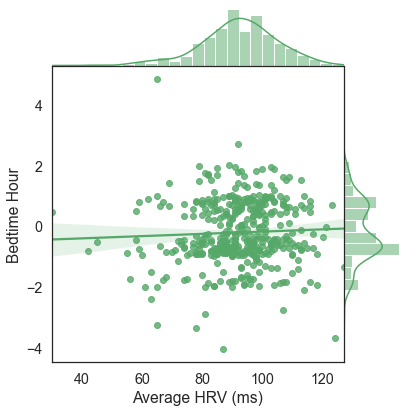

In [75]:
with sns.axes_style("white"):
    sns.jointplot(data=dataframe_lowbooze, x='Average HRV (ms)', y=col, kind='reg', color='g', space=0)

/Users/maxfrenzel/venvs/py3/lib/python3.8/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


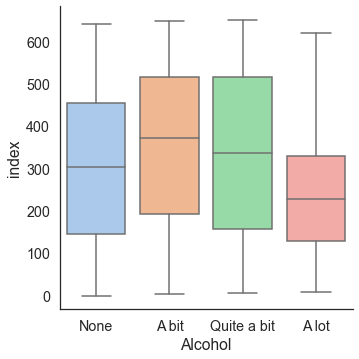

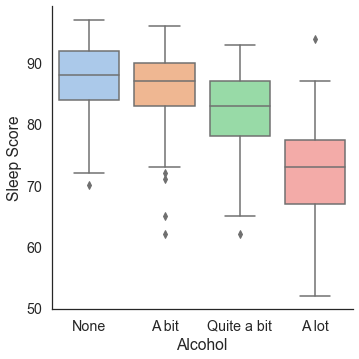

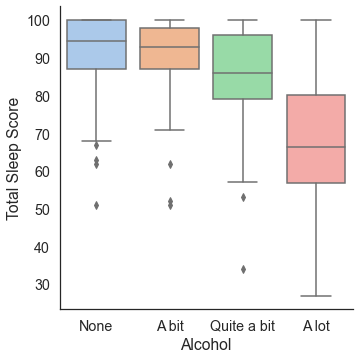

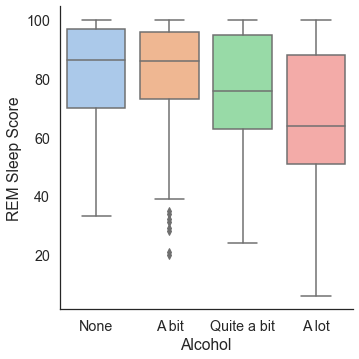

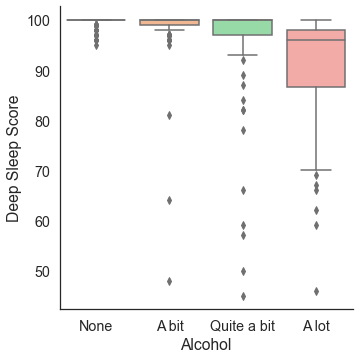

...

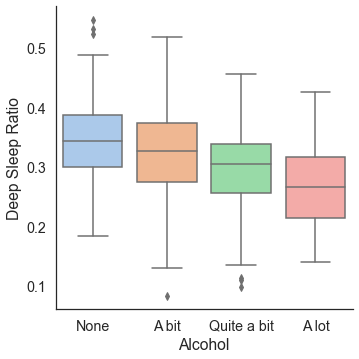

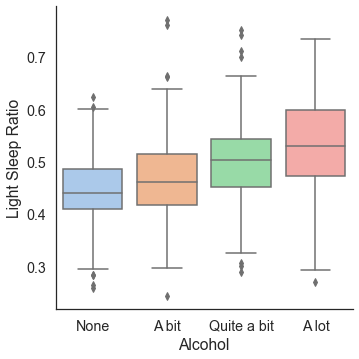

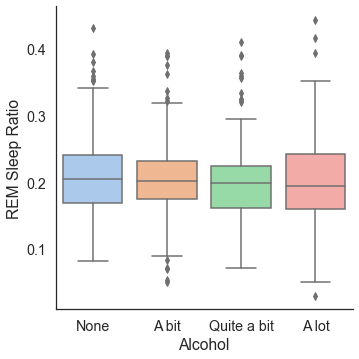

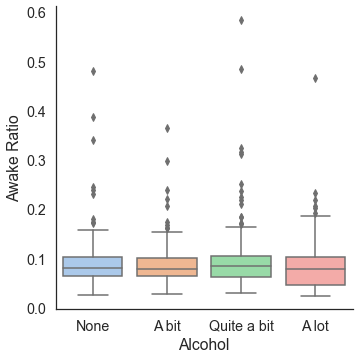

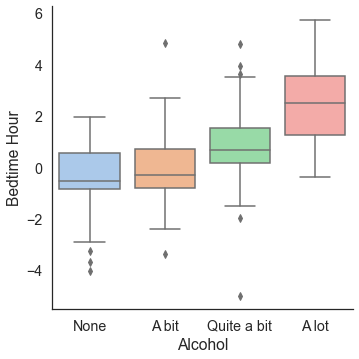

In [76]:
with sns.axes_style("white"):
    for col in list(dataframe):
        if dataframe[col].dtype in (float64, int64):
            try:
                sns.catplot(x="Alcohol", y=col, kind="box", data=dataframe, palette="pastel")
            except:
                pass

In [77]:
# Look at moving averages

window_size = 14

df_moving = pd.DataFrame()

# Go through all keys in dataframe and add their moving averagews to new df
for key in dataframe.keys():
    if dataframe[key].dtype in [int, float]:
        df_moving[key] = dataframe[key].rolling(window=window_size).mean()
    else:
        df_moving[key] = dataframe[key]
    
df_moving = df_moving[window_size-1:].drop(['index'], axis=1).reset_index().drop(['index'], axis=1)
df_moving = df_moving.set_index('date')

In [78]:
df_moving

,Sleep Score,Total Sleep Score,REM Sleep Score,Deep Sleep Score,Sleep Efficiency Score,Restfulness Score,Sleep Latency Score,Sleep Timing Score,Restless Sleep,Sleep Efficiency,...,Sleep Latency (min),Respiratory Rate (1/min),Activity Burn (Cal),Average HRV (ms),Bedtime Caffeine (mg),Deep Sleep Ratio,Light Sleep Ratio,REM Sleep Ratio,Awake Ratio,Bedtime Hour
date,,,,,,,,,,,,,,,,,,,,,
2018-09-02,84.714286,85.928571,86.500000,93.071429,95.357143,91.142857,92.857143,42.000000,28.428571,91.357143,...,13.642857,13.000000,778.071429,84.714286,44.523263,0.252550,0.491959,0.255490,0.096440,0.959663
2018-09-03,84.714286,86.142857,84.428571,93.428571,97.214286,91.714286,92.928571,40.428571,28.642857,92.285714,...,14.142857,12.848214,765.571429,85.071429,46.365759,0.261213,0.493273,0.245514,0.084583,1.141587
2018-09-04,84.642857,86.142857,83.428571,93.357143,97.214286,92.214286,92.214286,40.714286,28.214286,92.285714,...,14.678571,12.866071,776.642857,83.428571,48.172261,0.256095,0.500950,0.242955,0.084432,1.158353
2018-09-05,82.785714,83.357143,79.071429,93.142857,95.642857,91.714286,91.642857,39.142857,27.857143,91.500000,...,14.178571,12.883929,789.214286,81.214286,46.044717,0.258976,0.506169,0.234855,0.094869,1.171706
2018-09-06,83.500000,84.214286,80.500000,92.928571,95.857143,92.071429,92.071429,41.142857,27.928571,91.714286,...,13.464286,12.866071,783.000000,81.357143,47.561182,0.251402,0.504439,0.244159,0.092012,1.002956
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-12-26,85.214286,93.071429,74.714286,98.857143,92.071429,81.500000,87.928571,51.000000,23.142857,89.357143,...,15.357143,12.678571,435.357143,63.571429,95.906471,0.283313,0.542088,0.174599,0.121789,-0.348036
2020-12-27,85.428571,93.357143,74.642857,99.000000,92.285714,82.357143,87.714286,50.714286,23.357143,89.571429,...,15.571429,12.687500,439.500000,63.928571,91.861365,0.286948,0.539908,0.173143,0.119148,-0.352401
2020-12-29,85.428571,94.571429,75.714286,98.857143,92.428571,81.500000,88.071429,46.428571,23.428571,89.785714,...,14.714286,12.678571,431.928571,63.785714,94.568967,0.276037,0.551063,0.172900,0.117449,-0.155853


<ipython-input-79-eb25f6c97c10>:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure();


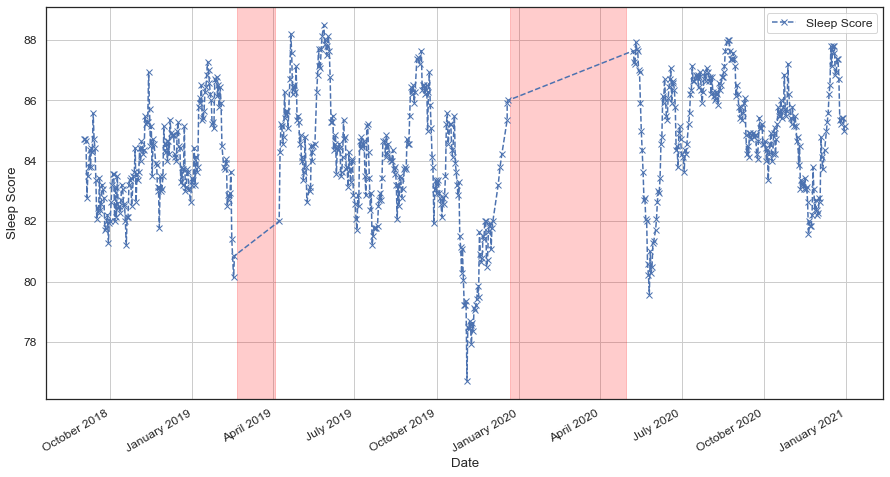

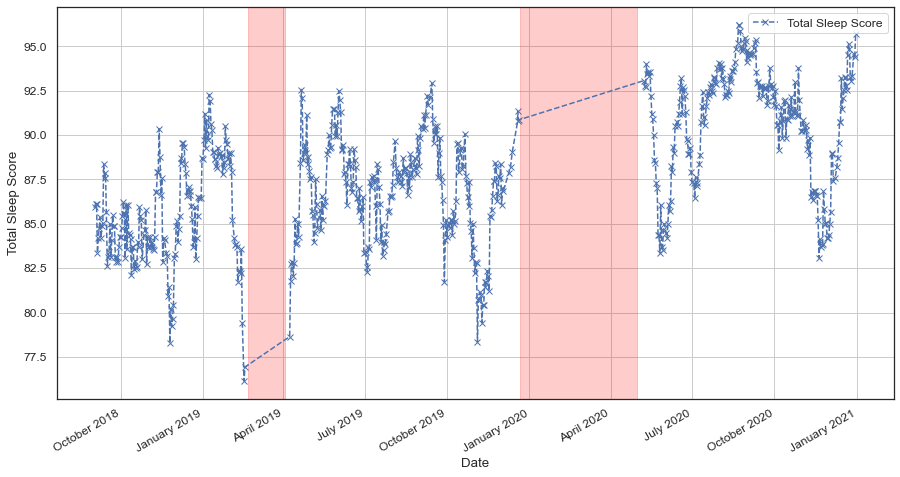

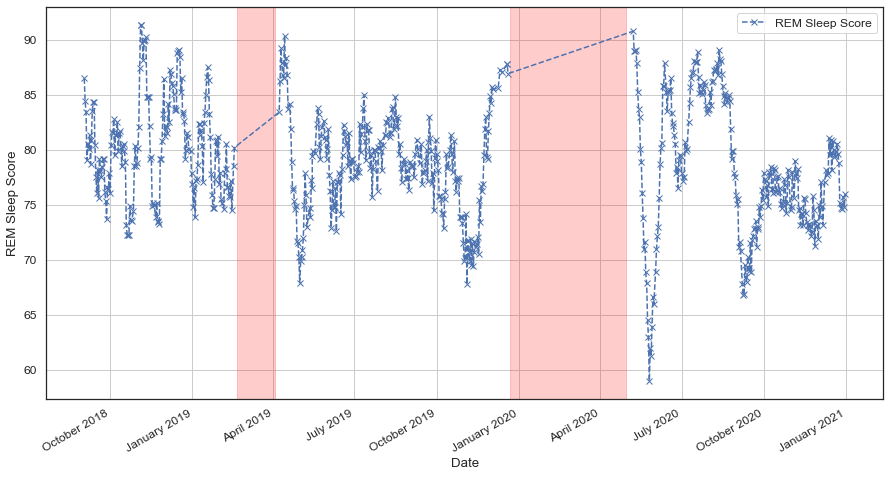

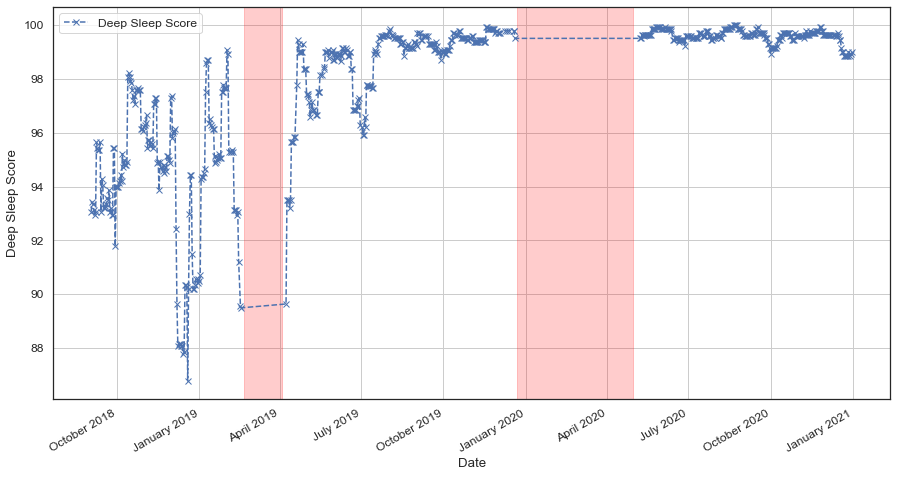

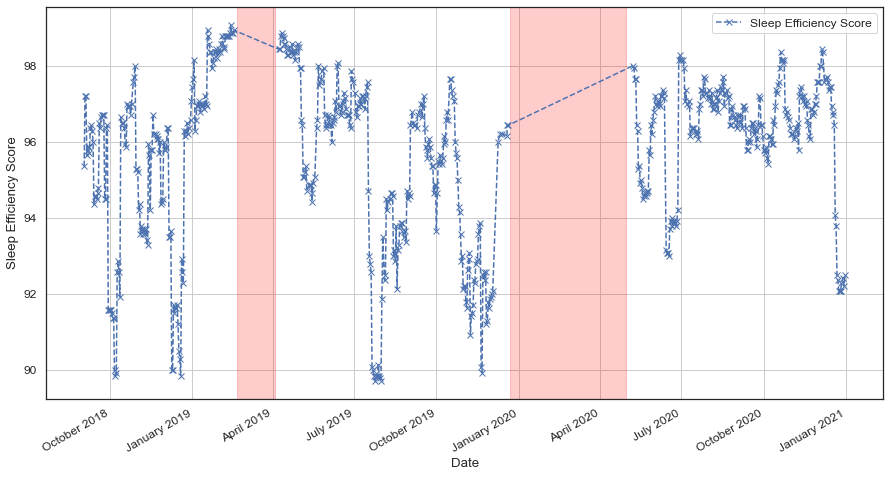

...

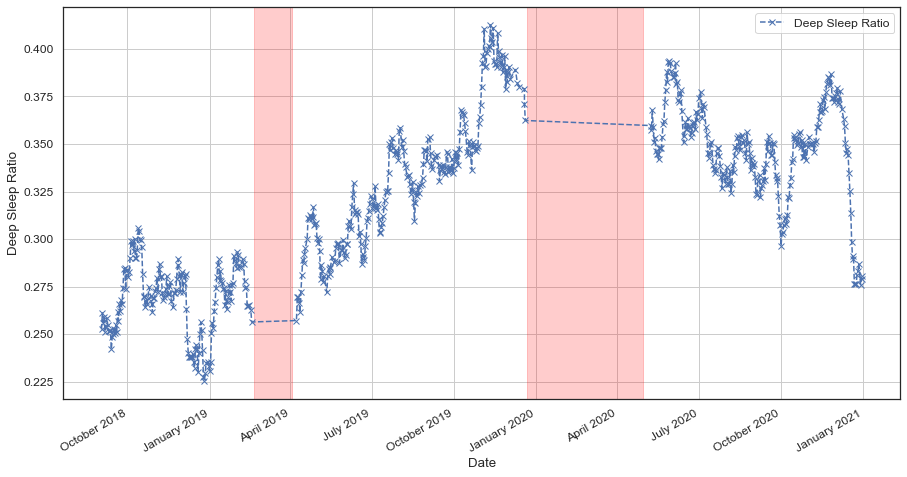

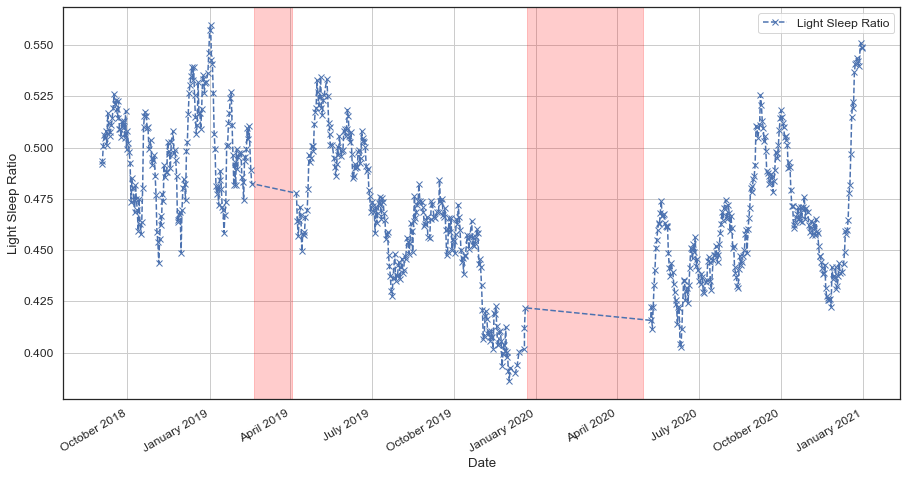

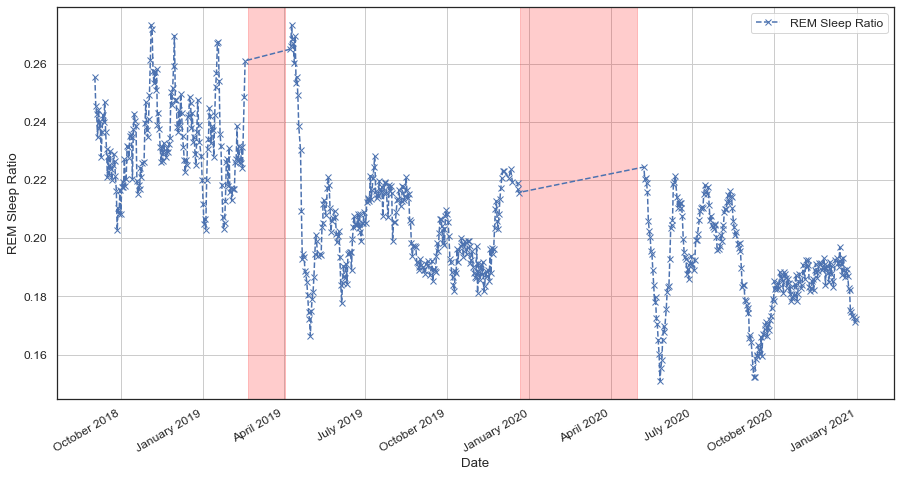

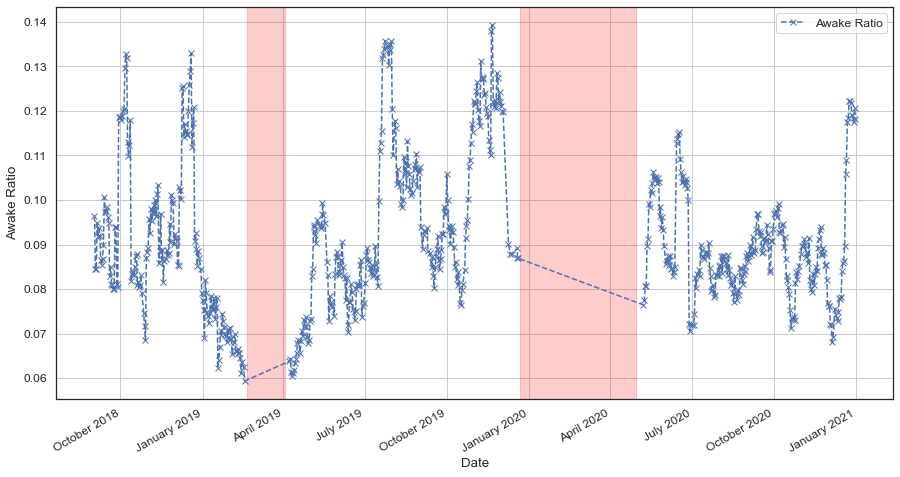

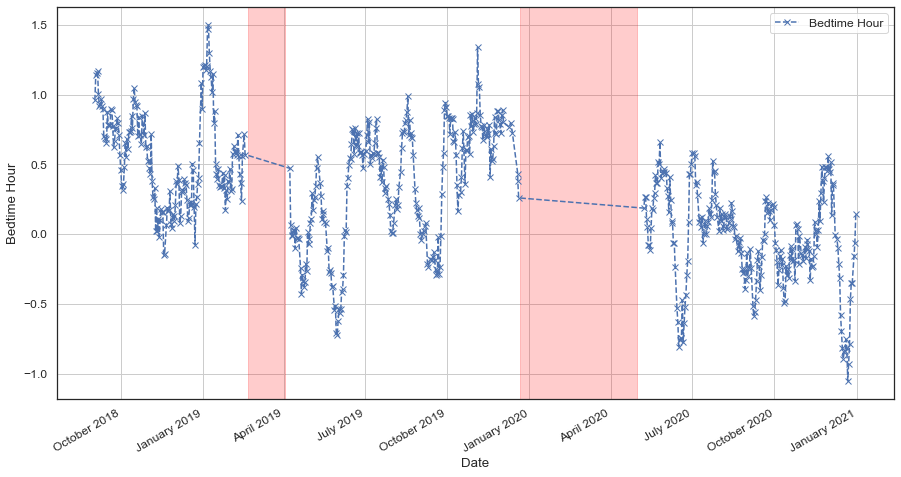

In [79]:
sns.set(font_scale=1.1)
with sns.axes_style("white"): 
    for key in df_moving.keys():
        if df_moving[key].dtype in [int, float]:
            plt.figure();
            ax = df_moving[key].plot(style='x--')
    #         ax2 = df_moving[pair[1]].plot(secondary_y=True, style='x--')
            ax.set_ylabel(key);
    #         ax2.set_ylabel(pair[1]);
            ax.legend()
    #         ax2.legend()
            ax.grid()
            plt.xlabel('Date')
    #         ax2.grid()
            date_form = DateFormatter("%B %Y")
            ax.xaxis.set_major_formatter(date_form)
            plt.gcf().autofmt_xdate()
            ax.axvspan(datetime.datetime(2019, 2, 20), datetime.datetime(2019, 4, 3), alpha=0.2, color='red')
            ax.axvspan(datetime.datetime(2019, 12, 22), datetime.datetime(2020, 4, 30), alpha=0.2, color='red')

# for key in df_moving.keys():
#     if df_moving[key].dtype in [int, float]:
#         plt.figure();
#         ax = df_moving[key].plot()
#         ax.set_ylabel(key);

In [80]:
df_moving.keys()

Index(['Sleep Score', 'Total Sleep Score', 'REM Sleep Score',
       'Deep Sleep Score', 'Sleep Efficiency Score', 'Restfulness Score',
       'Sleep Latency Score', 'Sleep Timing Score', 'Restless Sleep',
       'Sleep Efficiency', 'Sleep Timing', 'Bedtime Start', 'Bedtime End',
       'Average Resting Heart Rate', 'Lowest Resting Heart Rate',
       'Average HRV', 'Temperature Deviation (°C)', 'Activity Score',
       'Stay Active Score', 'Move Every Hour Score',
       'Meet Daily Targets Score', 'Training Frequency Score',
       'Training Volume Score', 'Recovery Time Score', 'Total Burn',
       'Target Calories', 'Steps', 'Daily Movement', 'Inactive Time',
       'Rest Time', 'Low Activity Time', 'Medium Activity Time',
       'High Activity Time', 'Non-wear Time', 'Average MET',
       'Long Periods of Inactivity', 'Readiness Score', 'Previous Night Score',
       'Sleep Balance Score', 'Previous Day Activity Score',
       'Activity Balance Score', 'Temperature Score',
       

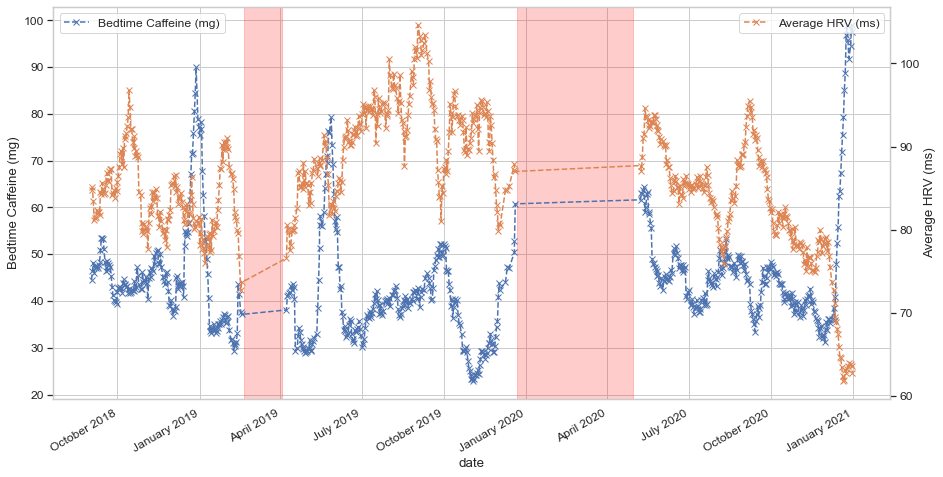

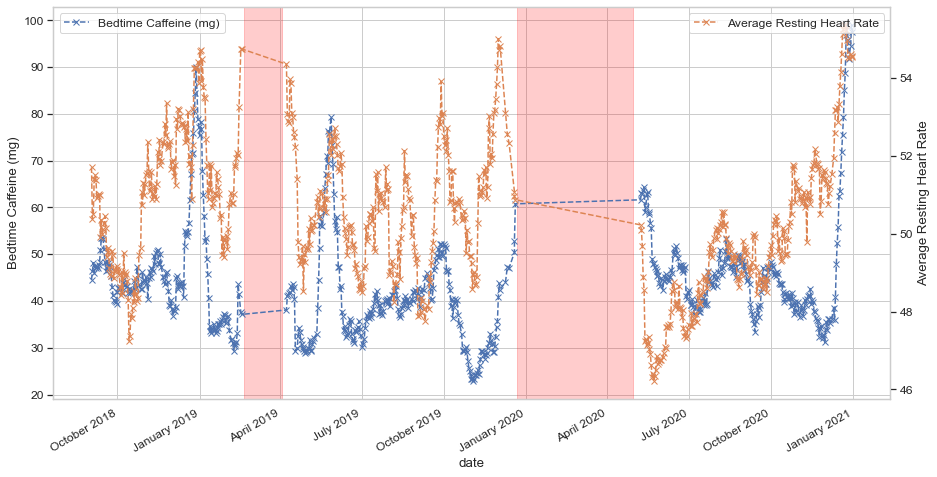

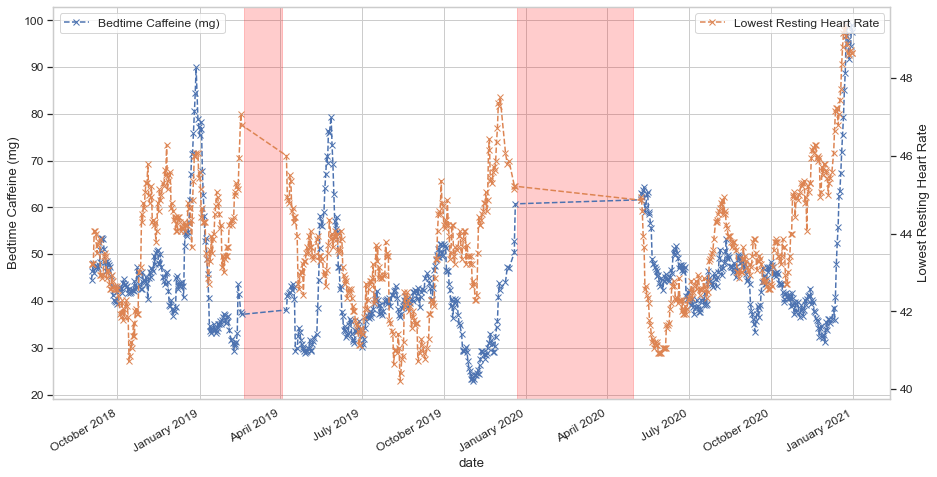

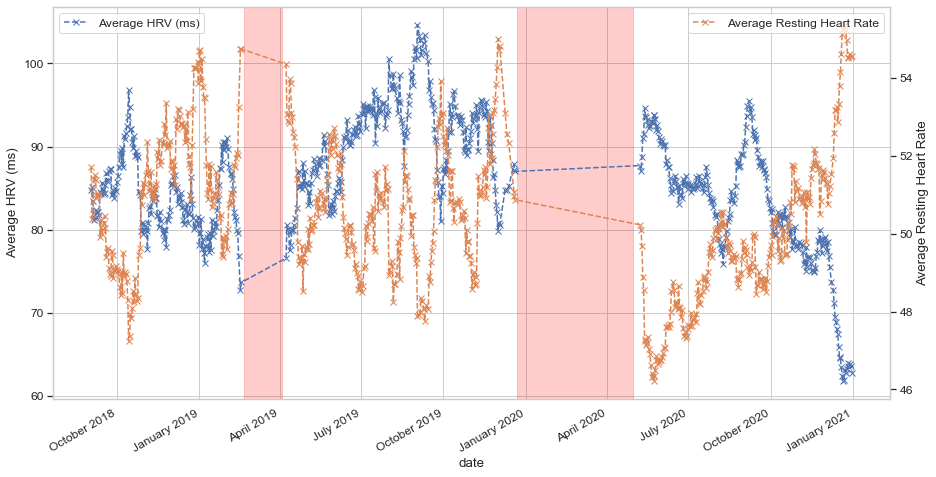

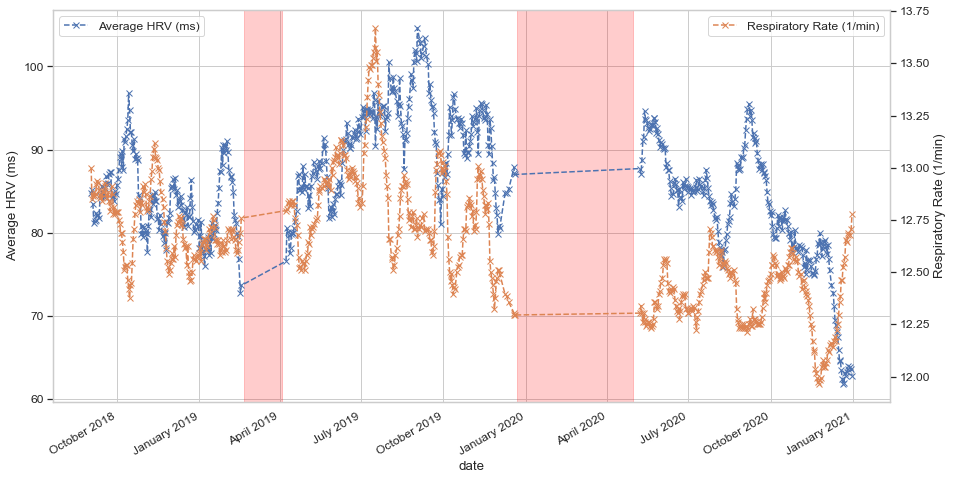

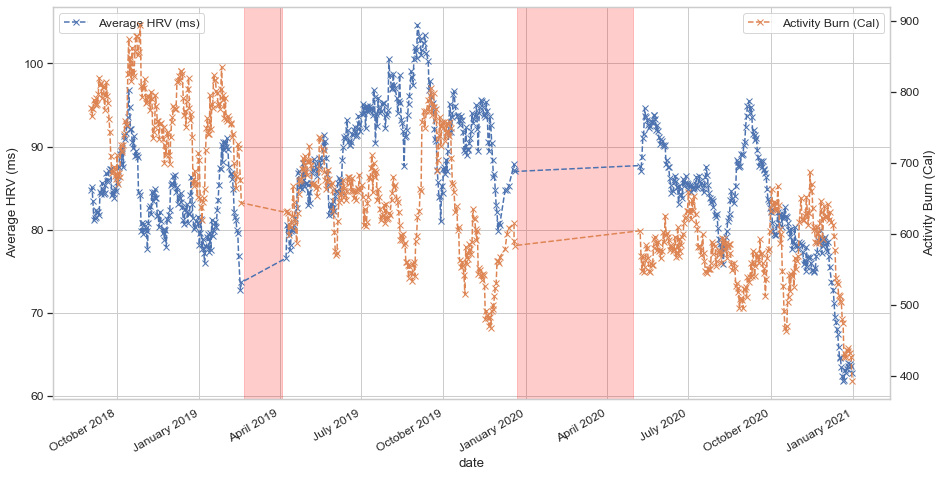

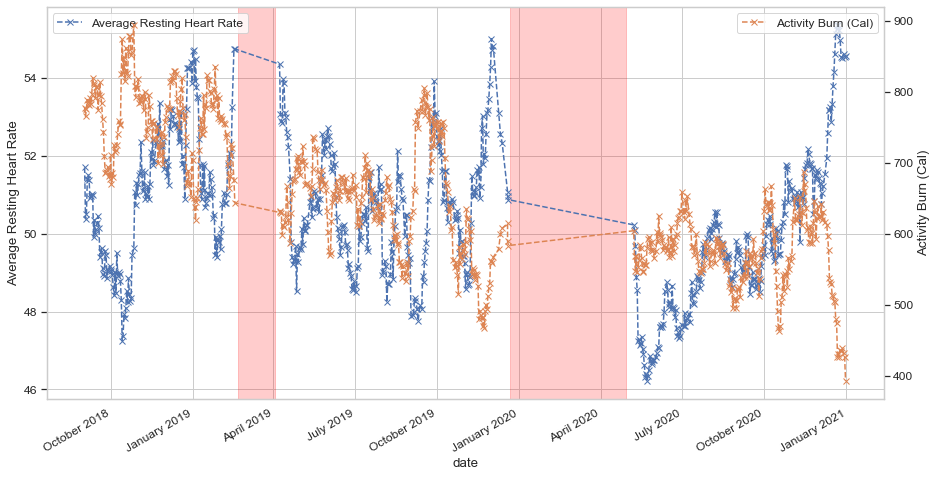

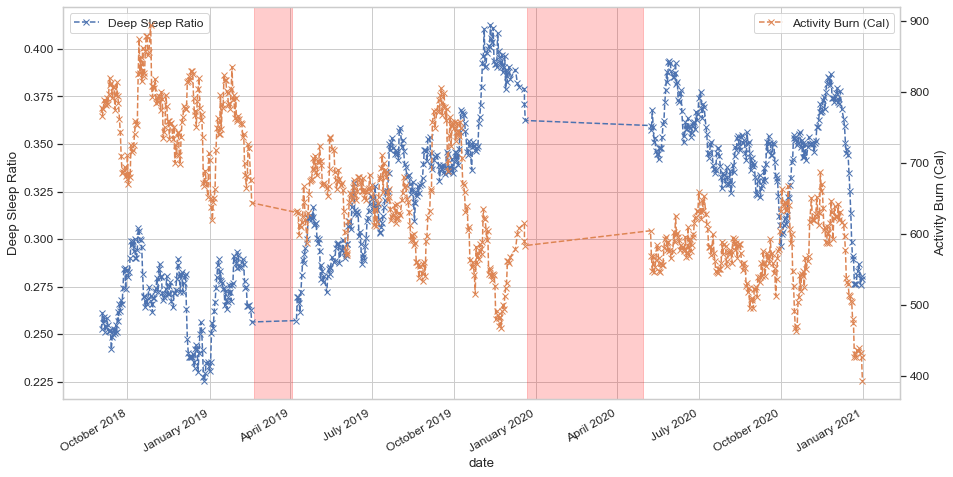

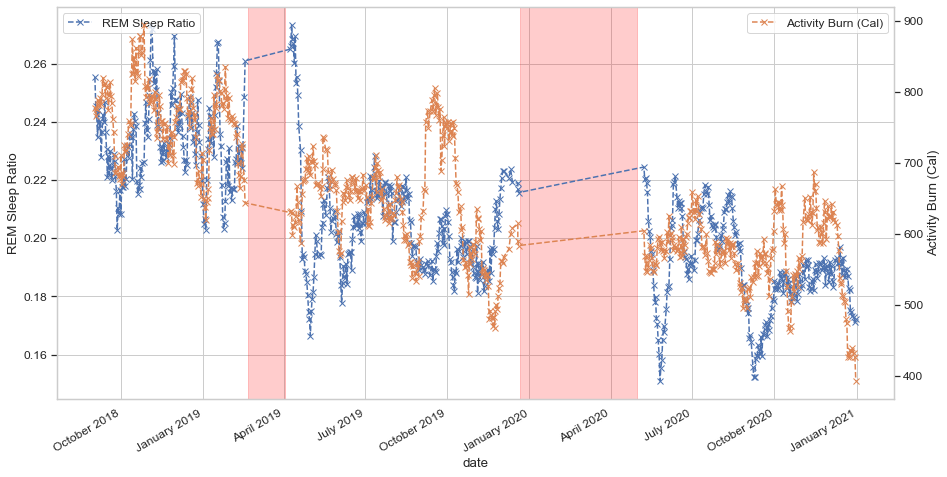

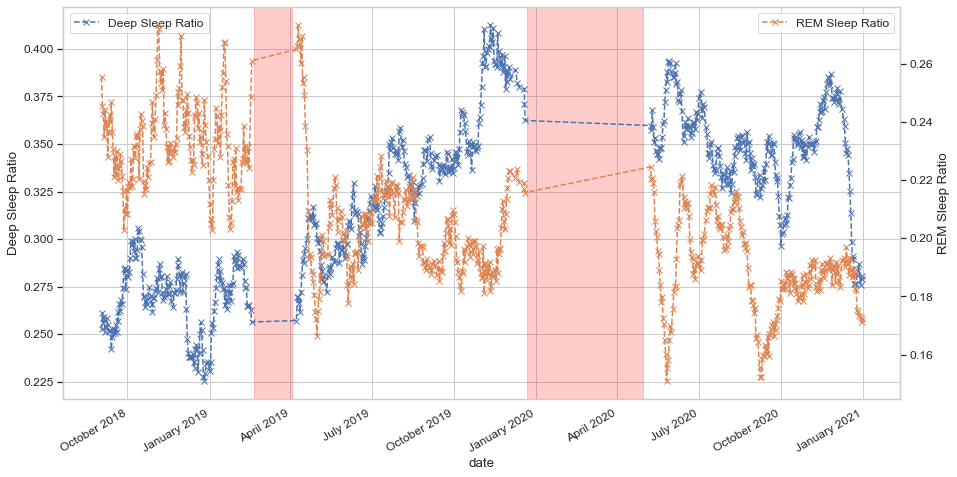

In [82]:
# Look at pairs

interesting_pairs = [
    ['Bedtime Caffeine (mg)', 'Average HRV (ms)'],
    ['Bedtime Caffeine (mg)', 'Average Resting Heart Rate'],
    ['Bedtime Caffeine (mg)', 'Lowest Resting Heart Rate'],
    ['Average HRV (ms)', 'Average Resting Heart Rate'],
    ['Average HRV (ms)', 'Respiratory Rate (1/min)'],
    ['Average HRV (ms)', 'Activity Burn (Cal)'],
    ['Average Resting Heart Rate', 'Activity Burn (Cal)'],
    ['Deep Sleep Ratio', 'Activity Burn (Cal)'],
    ['REM Sleep Ratio', 'Activity Burn (Cal)'],
    ['Deep Sleep Ratio', 'REM Sleep Ratio']
]

with sns.axes_style("whitegrid"):
    for pair in interesting_pairs:
        plt.figure();
        ax = df_moving[pair[0]].plot(style='x--')
        date_form = DateFormatter("%B %Y")
        ax.xaxis.set_major_formatter(date_form)
        ax2 = df_moving[pair[1]].plot(secondary_y=True, style='x--')
        ax.set_ylabel(pair[0]);
        ax2.set_ylabel(pair[1]);
        plt.xlabel('Date')
        ax.legend(loc='upper left')
        ax2.legend(loc='upper right')
        ax.grid()
        ax2.grid()
        plt.gcf().autofmt_xdate()
        ax.axvspan(datetime.datetime(2019, 2, 20), datetime.datetime(2019, 4, 3), alpha=0.2, color='red')
        ax.axvspan(datetime.datetime(2019, 12, 22), datetime.datetime(2020, 4, 30), alpha=0.2, color='red')
    
#     plt.fill_between(0, 100, 100, color="b", alpha=0.2);

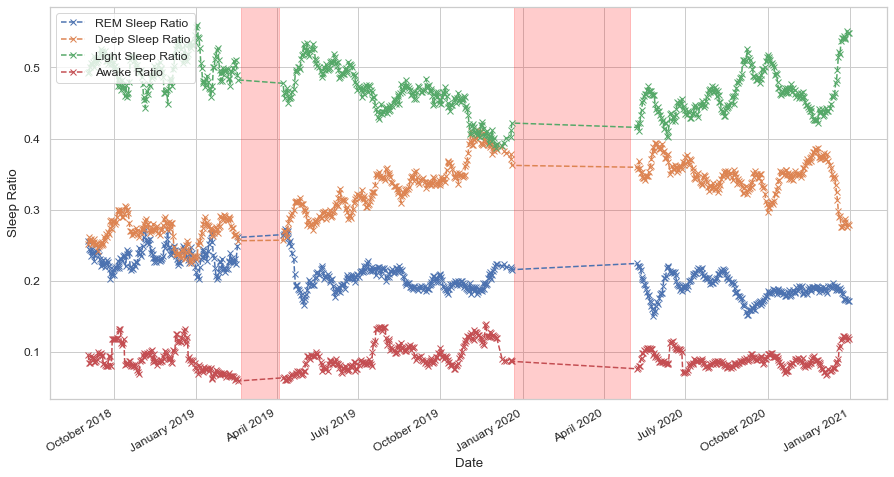

In [83]:
with sns.axes_style("whitegrid"):
    plt.figure();
    ax = df_moving['REM Sleep Ratio'].plot(style='x--')
    date_form = DateFormatter("%B %Y")
    ax.xaxis.set_major_formatter(date_form)
    ax2 = df_moving['Deep Sleep Ratio'].plot(style='x--')
    ax3 = df_moving['Light Sleep Ratio'].plot(style='x--')
    ax3 = df_moving['Awake Ratio'].plot(style='x--')
    ax.set_ylabel('Sleep Ratio');
    ax.legend(loc='upper left')
    plt.xlabel('Date')
#     ax2.legend(loc='upper right')
    ax.grid()
    ax3.grid()
    plt.gcf().autofmt_xdate()
    ax.axvspan(datetime.datetime(2019, 2, 20), datetime.datetime(2019, 4, 3), alpha=0.2, color='red')
    ax.axvspan(datetime.datetime(2019, 12, 22), datetime.datetime(2020, 4, 30), alpha=0.2, color='red')

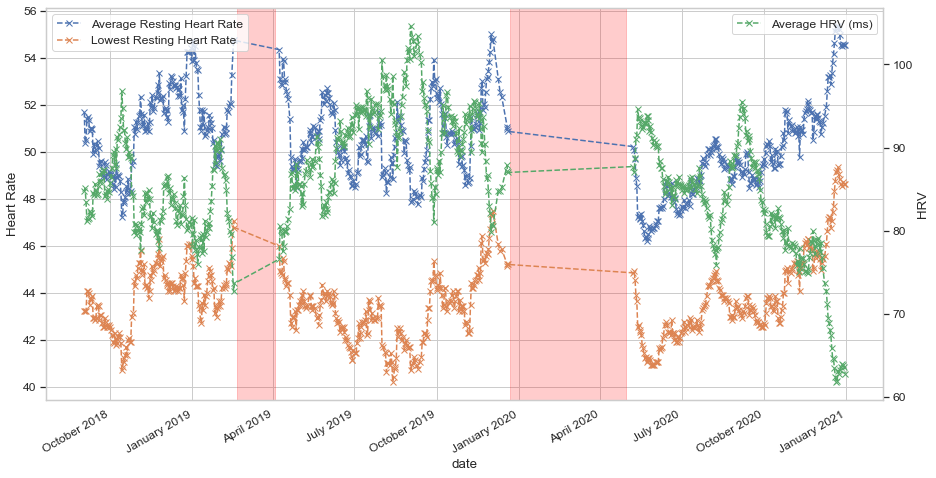

In [84]:
with sns.axes_style("whitegrid"):
    plt.figure();
    ax = df_moving['Average Resting Heart Rate'].plot(style='x--')
    date_form = DateFormatter("%B %Y")
    ax.xaxis.set_major_formatter(date_form)
    ax2 = df_moving['Lowest Resting Heart Rate'].plot(style='x--')
    ax3 = df_moving['Average HRV (ms)'].plot(secondary_y=True, style='x--')
#     ax3 = df_moving['Awake Ratio'].plot(style='x--')
    ax.set_ylabel('Heart Rate');
    ax3.set_ylabel('HRV');
    ax.legend(loc='upper left')
    plt.xlabel('Date')
    ax3.legend(loc='upper right')
    ax.grid()
    ax3.grid()
    plt.gcf().autofmt_xdate()
    ax.axvspan(datetime.datetime(2019, 2, 20), datetime.datetime(2019, 4, 3), alpha=0.2, color='red')
    ax.axvspan(datetime.datetime(2019, 12, 22), datetime.datetime(2020, 4, 30), alpha=0.2, color='red')

In [85]:
datetime.datetime.today().timestamp()

1610159980.644784

In [86]:
series = pd.Series(0, index=df_moving.columns)
series['date'] = 5
df_test = df_moving.append(series, ignore_index=True)
# df_test['date'][-1] = 5
df_test

,Sleep Score,Total Sleep Score,REM Sleep Score,Deep Sleep Score,Sleep Efficiency Score,Restfulness Score,Sleep Latency Score,Sleep Timing Score,Restless Sleep,Sleep Efficiency,...,Respiratory Rate (1/min),Activity Burn (Cal),Average HRV (ms),Bedtime Caffeine (mg),Deep Sleep Ratio,Light Sleep Ratio,REM Sleep Ratio,Awake Ratio,Bedtime Hour,date
0,84.714286,85.928571,86.500000,93.071429,95.357143,91.142857,92.857143,42.000000,28.428571,91.357143,...,13.000000,778.071429,84.714286,44.523263,0.252550,0.491959,0.255490,0.096440,0.959663,NaN
1,84.714286,86.142857,84.428571,93.428571,97.214286,91.714286,92.928571,40.428571,28.642857,92.285714,...,12.848214,765.571429,85.071429,46.365759,0.261213,0.493273,0.245514,0.084583,1.141587,NaN
2,84.642857,86.142857,83.428571,93.357143,97.214286,92.214286,92.214286,40.714286,28.214286,92.285714,...,12.866071,776.642857,83.428571,48.172261,0.256095,0.500950,0.242955,0.084432,1.158353,NaN
3,82.785714,83.357143,79.071429,93.142857,95.642857,91.714286,91.642857,39.142857,27.857143,91.500000,...,12.883929,789.214286,81.214286,46.044717,0.258976,0.506169,0.234855,0.094869,1.171706,NaN
4,83.500000,84.214286,80.500000,92.928571,95.857143,92.071429,92.071429,41.142857,27.928571,91.714286,...,12.866071,783.000000,81.357143,47.561182,0.251402,0.504439,0.244159,0.092012,1.002956,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
615,85.428571,93.357143,74.642857,99.000000,92.285714,82.357143,87.714286,50.714286,23.357143,89.571429,...,12.687500,439.500000,63.928571,91.861365,0.286948,0.539908,0.173143,0.119148,-0.352401,NaN
616,85.428571,94.571429,75.714286,98.857143,92.428571,81.500000,88.071429,46.428571,23.428571,89.785714,...,12.678571,431.928571,63.785714,94.568967,0.276037,0.551063,0.172900,0.117449,-0.155853,NaN
617,85.000000,94.428571,74.785714,98.928571,92.214286,80.571429,88.642857,44.642857,23.071429,89.500000,...,12.705357,426.857143,63.571429,99.021301,0.280549,0.548336,0.171115,0.120588,-0.059782,NaN
618,85.142857,95.714286,76.000000,99.000000,92.500000,79.857143,88.428571,41.142857,22.928571,89.714286,...,12.776786,393.214286,62.785714,97.579451,0.278861,0.548943,0.172195,0.118173,0.142063,NaN


In [87]:
# Look at individual weekdays

weekday_list = []
weekday_list_low_booze = []

int2day = {
    0: 'Monday',
    1: 'Tuesday',
    2: 'Wednesday',
    3: 'Thursday',
    4: 'Friday',
    5: 'Saturday',
    6: 'Sunday'
}

for index, row in dataframe.iterrows():
    weekday_list.append(int2day[row['date'].weekday()])
    
for index, row in dataframe_lowbooze.iterrows():
    weekday_list_low_booze.append(int2day[row['date'].weekday()])

dataframe['Weekday'] = weekday_list
dataframe_lowbooze['Weekday'] = weekday_list_low_booze

dataframe

,index,date,Sleep Score,Total Sleep Score,REM Sleep Score,Deep Sleep Score,Sleep Efficiency Score,Restfulness Score,Sleep Latency Score,Sleep Timing Score,...,Respiratory Rate (1/min),Activity Burn (Cal),Average HRV (ms),Bedtime Caffeine (mg),Deep Sleep Ratio,Light Sleep Ratio,REM Sleep Ratio,Awake Ratio,Bedtime Hour,Weekday
0,0,2018-08-20,87.0,90.0,100.0,95.0,72.0,85.0,93.0,68.0,...,14.500,1211,95.0,38.080655,0.197581,0.493952,0.308468,0.245968,-1.712500,Monday
1,1,2018-08-21,86.0,85.0,82.0,100.0,98.0,91.0,98.0,50.0,...,12.250,864,114.0,36.614506,0.359326,0.433087,0.207587,0.074816,0.583056,Tuesday
2,2,2018-08-22,90.0,97.0,82.0,100.0,98.0,91.0,98.0,46.0,...,12.875,497,95.0,49.342117,0.276254,0.536424,0.187323,0.072848,0.929722,Wednesday
3,3,2018-08-23,86.0,88.0,80.0,99.0,97.0,90.0,88.0,51.0,...,12.875,1024,97.0,57.795377,0.289990,0.510836,0.199174,0.091847,0.852222,Thursday
4,4,2018-08-24,83.0,79.0,99.0,96.0,97.0,88.0,93.0,41.0,...,12.625,688,86.0,48.262063,0.242152,0.439462,0.318386,0.089686,0.271667,Friday
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
627,646,2020-12-26,86.0,95.0,76.0,100.0,97.0,81.0,97.0,40.0,...,12.625,400,59.0,66.018306,0.334634,0.488780,0.176585,0.082927,0.804444,Saturday
628,647,2020-12-27,91.0,100.0,95.0,99.0,98.0,87.0,94.0,43.0,...,12.750,305,60.0,66.205628,0.259944,0.527290,0.212766,0.078631,-0.933889,Sunday
629,648,2020-12-29,86.0,100.0,87.0,98.0,99.0,70.0,86.0,36.0,...,12.625,387,65.0,130.381058,0.222515,0.595427,0.182058,0.069481,0.983889,Tuesday
630,649,2020-12-30,85.0,95.0,75.0,100.0,97.0,73.0,97.0,43.0,...,13.000,516,55.0,135.124175,0.321289,0.502930,0.175781,0.089844,0.878611,Wednesday


/Users/maxfrenzel/venvs/py3/lib/python3.8/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


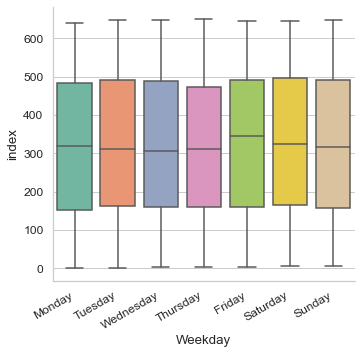

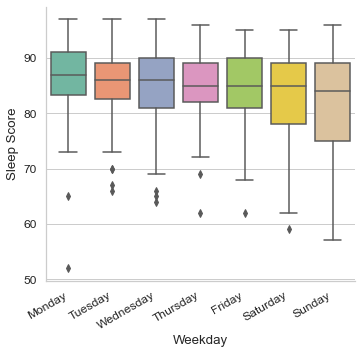

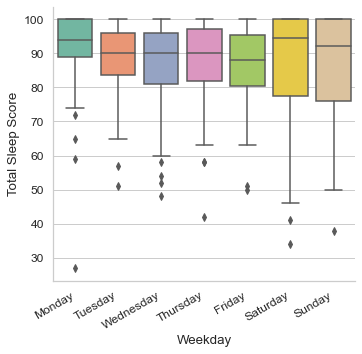

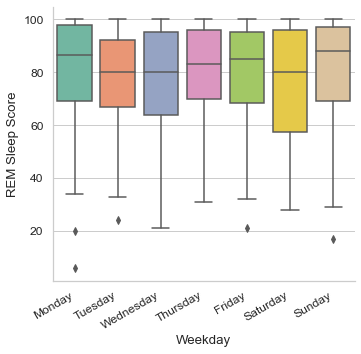

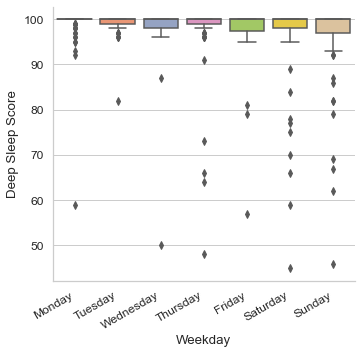

...

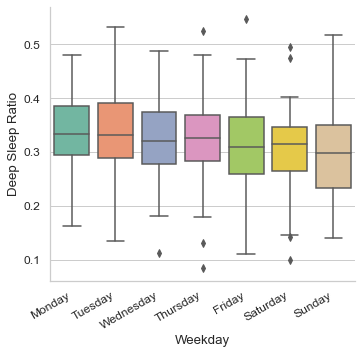

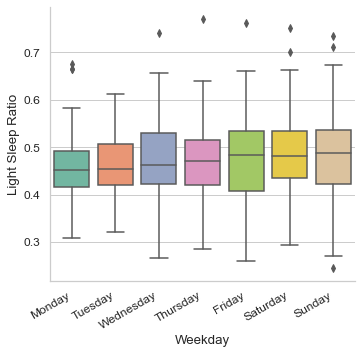

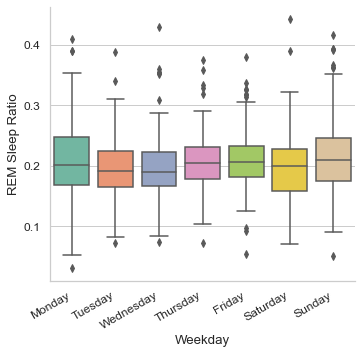

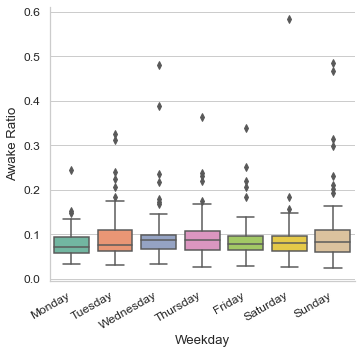

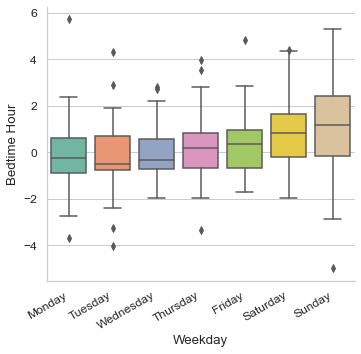

In [88]:
with sns.axes_style("whitegrid"):
    for col in list(dataframe):
        if dataframe[col].dtype in (float64, int64):
            try:
                sns.catplot(x="Weekday", y=col, kind="box", data=dataframe, palette=sns.color_palette("Set2"))
                plt.gcf().autofmt_xdate()
            except:
                pass

/Users/maxfrenzel/venvs/py3/lib/python3.8/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


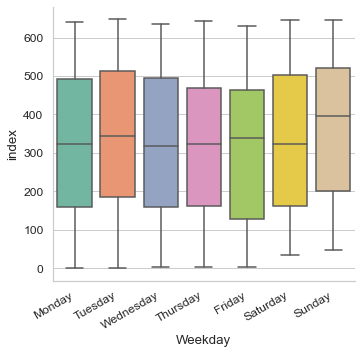

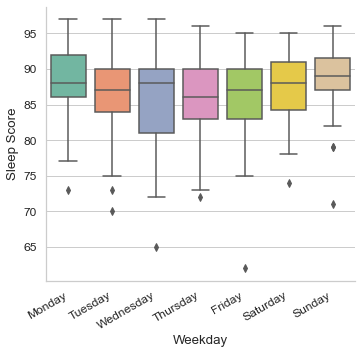

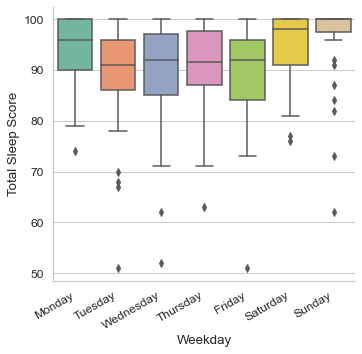

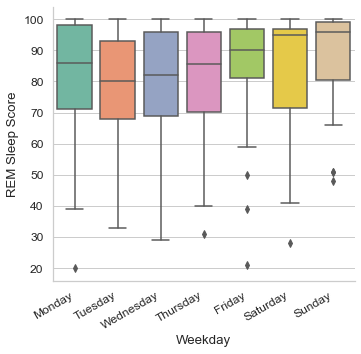

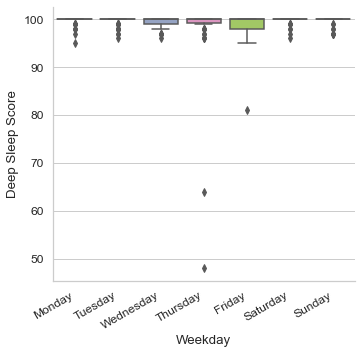

...

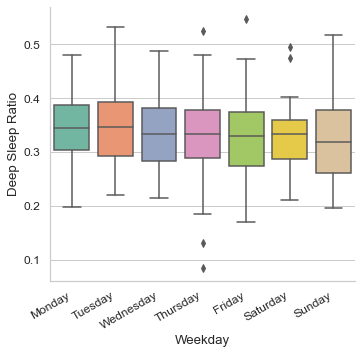

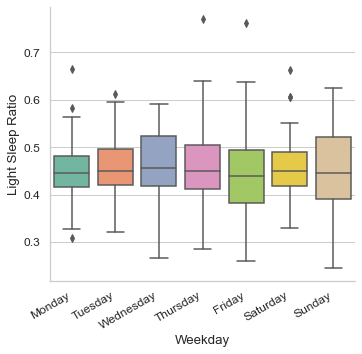

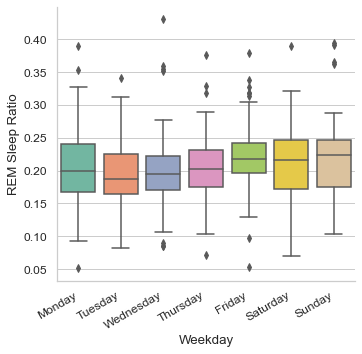

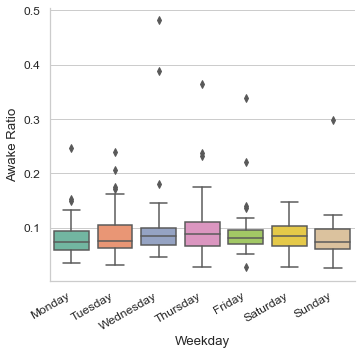

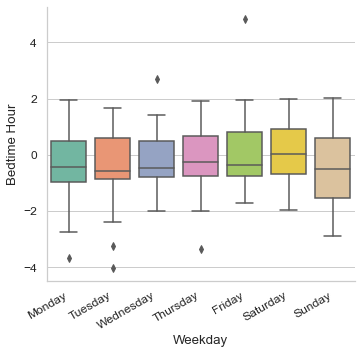

In [89]:
with sns.axes_style("whitegrid"):
    for col in list(dataframe_lowbooze):
        if dataframe_lowbooze[col].dtype in (float64, int64):
            try:
                sns.catplot(x="Weekday", y=col, kind="box", data=dataframe_lowbooze, palette=sns.color_palette("Set2"))
                plt.gcf().autofmt_xdate()
            except:
                pass